### Udacity Self-Driving Car Engineer Nanodegree
# Project 4 &mdash; Advanced Lane Detection
---

## Overview

#### The goals and steps of this project are:

1. Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
1. Apply a distortion correction to raw images.
1. Use color transforms, gradients, etc., to create a thresholded binary image.
1. Apply a perspective transform to rectify binary image ("birds-eye view").
1. Detect lane pixels and fit to find the lane boundary.
1. Determine the curvature of the lane and vehicle position with respect to center.
1. Warp the detected lane boundaries back onto the original image.
1. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

---

In [22]:
import cv2
import glob
from io import BytesIO
from IPython.display import Image
from ipywidgets import interact, interactive, fixed
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
import numpy as np
import pickle
from skimage import img_as_ubyte
from tqdm import tqdm

### Helper Functions

In [79]:
# Helper functions for displaying images within the notebook

def show_interactive(img):
    '''Display an image with interactive controls for tuning threshold parameters. 
    
    More info here:
    https://ipython.org/ipython-doc/3/api/generated/IPython.display.html#IPython.display.Image
    '''
    
    if img.ndim == 2:
        format, cmap = 'png', mpl.cm.gray
    elif img.ndim == 3:
        format, cmap = 'jpg', None
    else:
        raise ValueError("Only 2- or 3-d arrays can be displayed as images.")
        
    with BytesIO() as buffer:
        mpl.image.imsave(buffer, img, format=format, cmap=cmap, vmin=0, vmax=1.0)
        out = buffer.getvalue()
        
    return Image(out, width=600)


def show_RGB(img1, img2, title1='Undistorted', title2='Binary', chan1='BGR', chan2='GRAY'):
    '''Displays two images side-by-side using Matplotlib'''
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.set_axis_off(), ax2.set_axis_off()
    
    if chan1 == 'BGR':
        img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
    if chan2 == 'BGR':
        img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)    
        
    ax1.imshow(img1, cmap='gray')
    ax1.set_title(title1, fontsize=20)
    ax2.imshow(img2, cmap='gray')
    ax2.set_title(title2, fontsize=20)

---
## Step 1 | Camera Calibration

In [2]:
# Object point and image point placeholders
nx = 9
ny = 6
objp = np.zeros((ny*nx, 3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# List of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Locate the chessboard corners
for fname in tqdm(images):
    # Get image array and convert to grayscale
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    # If found, add object points, image points
    if ret:
        objpoints.append(objp)
        imgpoints.append(corners)

print('Calibration complete.')

100%|██████████| 20/20 [00:06<00:00,  2.99it/s]

Calibration complete.


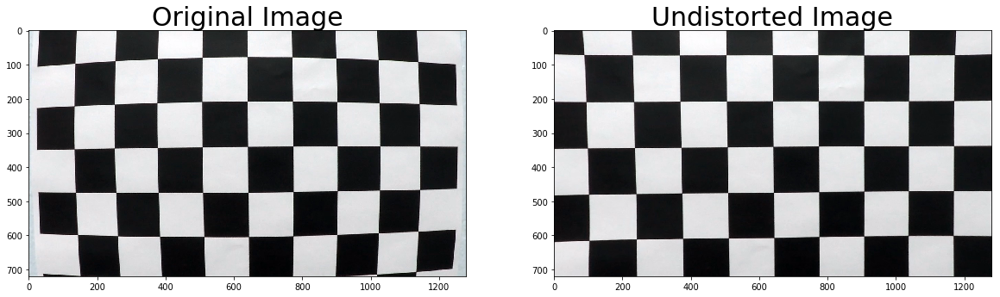

In [3]:
## Test the calibration by undistorting a chessboard image

img_dir = 'camera_cal/'

# Test image
test_img = 'calibration1.jpg'
img = cv2.imread(img_dir + test_img)
img_size = (img.shape[1], img.shape[0])

# Camera calibration 
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)

# Undistorted version
undist = cv2.undistort(img, mtx, dist, None, mtx)
cv2.imwrite(img_dir + 'test_undist.jpg', undist)

# Save the camera calibration result
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump(dist_pickle, open("camera_cal/calibration1.p", "wb" ) )

# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(undist)
ax2.set_title('Undistorted Image', fontsize=30)

---
## Step 2 | Distortion Correction

In [6]:
# Undistort function

def undistort(img):
    return cv2.undistort(img, mtx, dist, None, mtx)


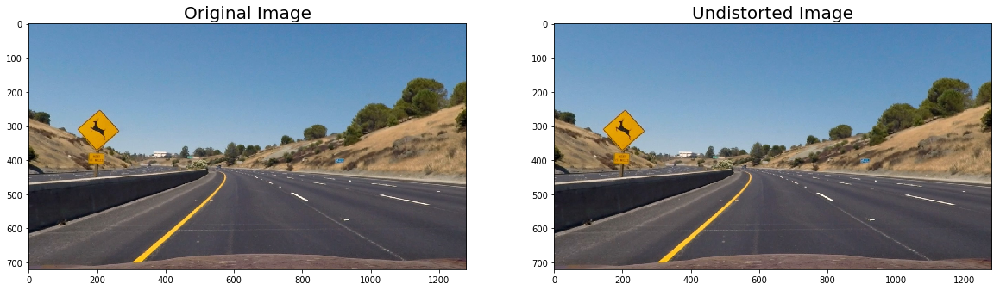

In [318]:
## Apply to driving images

# Original image
orig_img = cv2.imread('test_images/test2.jpg')

# Undistorted version
undist = undistort(orig_img)

# Visualize the images
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
ax1.set_title('Original Image', fontsize=20)
ax2.imshow(cv2.cvtColor(undist, cv2.COLOR_BGR2RGB))
ax2.set_title('Undistorted Image', fontsize=20)

### Create Undistorted Versions of Test Images

In [323]:
test1 = undistort(cv2.imread('test_images/test1.jpg'))  # challenging - light pavement
test2 = undistort(cv2.imread('test_images/test2.jpg'))  # optimal conditions
test3 = undistort(cv2.imread('test_images/test3.jpg'))  # optimal conditions
test4 = undistort(cv2.imread('test_images/test4.jpg'))  # challenging - light pavement, shadows
test5 = undistort(cv2.imread('test_images/test5.jpg'))  # challenging - light pavement, shadows
test6 = undistort(cv2.imread('test_images/test6.jpg'))  # challenging - light pavement, shadows

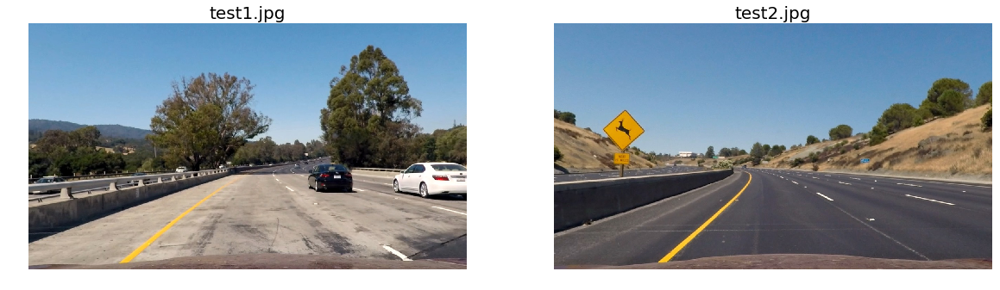

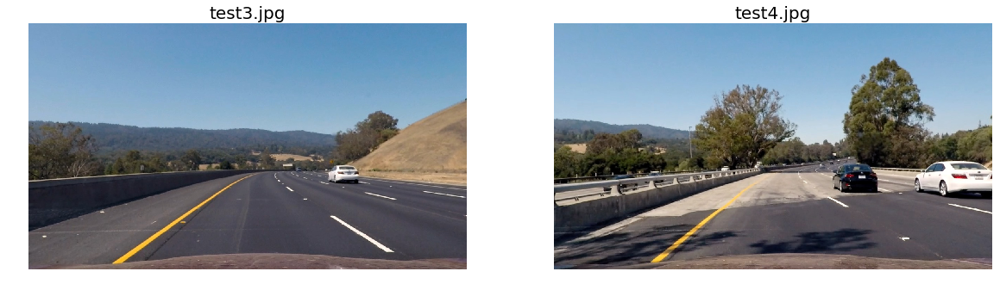

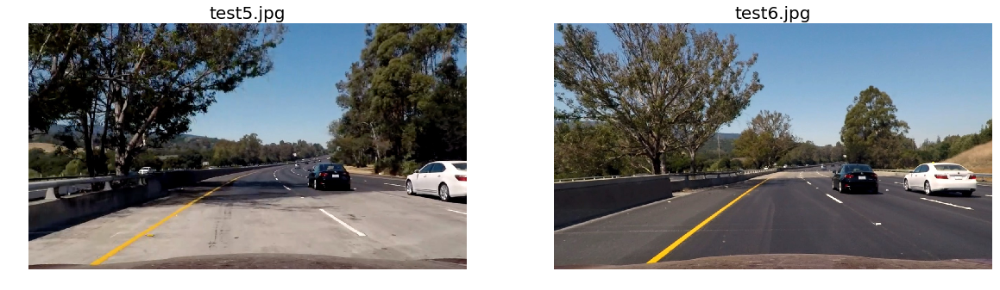

In [324]:
# Visualize the undistorted test images
show_RGB(test1, test2, chan1='BGR', chan2='BGR', title1='test1.jpg', title2='test2.jpg')
show_RGB(test3, test4, chan1='BGR', chan2='BGR', title1='test3.jpg', title2='test4.jpg') 
show_RGB(test5, test6, chan1='BGR', chan2='BGR', title1='test5.jpg', title2='test6.jpg') 

---
## Step 3.1 | Gradient Thresholds

### Directional Gradients for X or Y

In [52]:
# Directional gradient for X or Y using Sobel algorithm

def abs_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    
    # Convert to grayscale
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Absolulte value of x or y gradient 
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
    
    # Rescale to 8-bit integer
    scaled_sobel = np.uint8(255 * abs_sobel / np.max(abs_sobel))
    
    # Apply threshold
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    # Return the result
    return binary_output

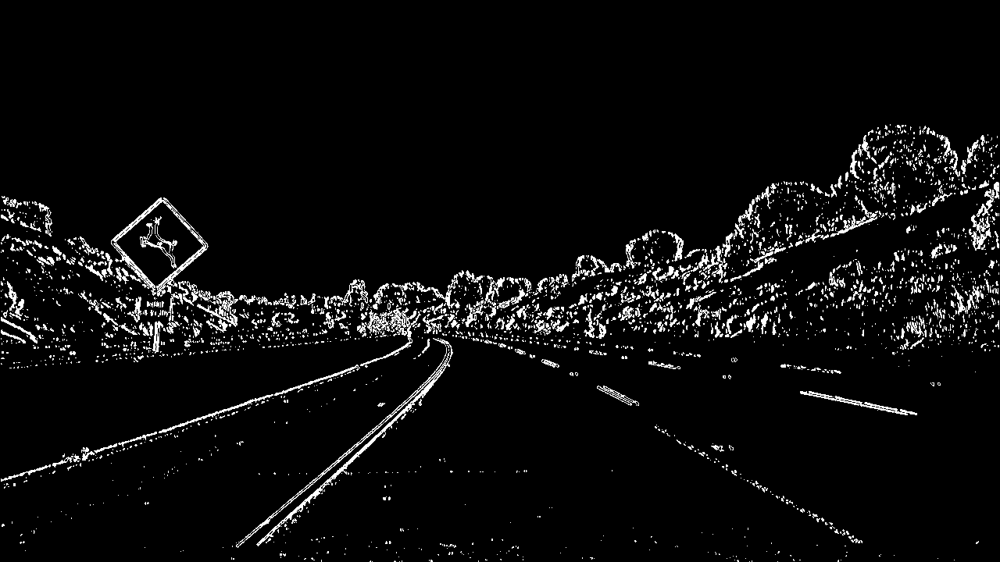

In [60]:
## Interactive version for tuning threshold parameters (only works while running Jupyter Notebook)
# More info here -- http://ipywidgets.readthedocs.io/en/stable/examples/Using%20Interact.html

@interact
def abs_thresh_image(image: fixed(undist), orient:('x','y')='x', sobel_kernel:(3,21,2)=3, 
                     thresh_min:(0,255)=30, thresh_max:(0,255)=100):
  
    binary = abs_thresh(image, orient, sobel_kernel, (thresh_min, thresh_max))
    
    return show_interactive(binary)
    

### Gradient Magnitude

In [65]:
# Gradient magnitude using both X and Y

def mag_thresh(img, sobel_kernel=3, thresh=(0, 255)):

    # Convert to grayscale
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # X and Y gradients
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    # Gradient magnitude
    mag = np.sqrt(sobelx**2 + sobely**2)
    
    # Rescale to 8-bit integer
    scaled_sobel = np.uint8(255 * mag / np.max(mag))
    
    # Apply threshold
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    # Return the binary image
    return binary_output

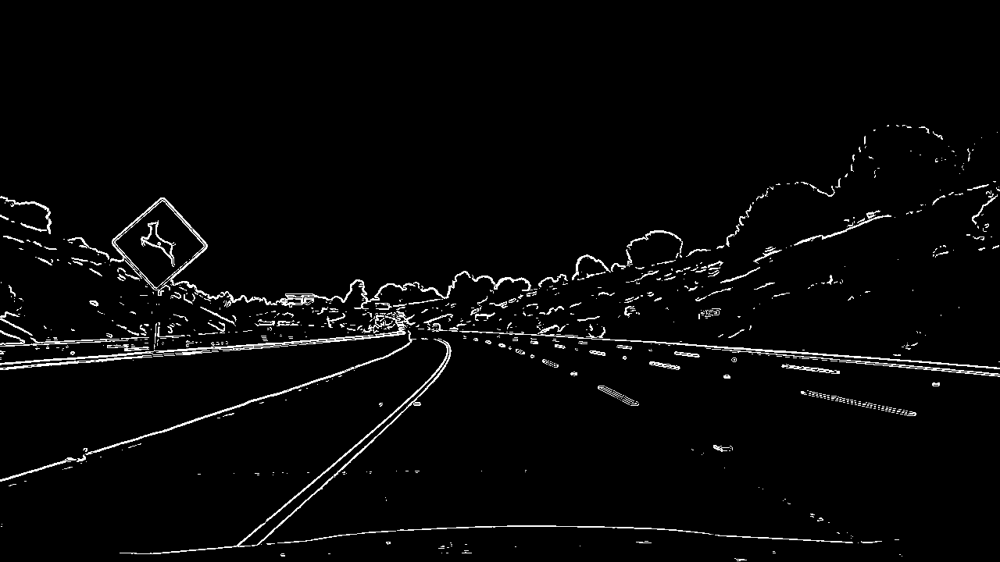

In [66]:
## Interactive version for tuning threshold parameters (only works while running Jupyter Notebook)

@interact
def mag_thresh_image(image: fixed(undist), sobel_kernel:(3,21,2)=3, thresh_min:(0,255)=30, thresh_max:(0,255)=100):
  
    mag_binary = mag_thresh(image, sobel_kernel, (thresh_min, thresh_max))
    
    return show_interactive(mag_binary)
    

### Gradient Direction

In [90]:
# Calculate the gradient direction

def dir_thresh(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    # Convert to grayscale
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Take the gradient in x and y separately
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    # Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    
    # Calculate the direction of the gradient 
    grad_dir = np.arctan2(abs_sobely, abs_sobelx)
    
    # Create a binary mask 
    binary_output = np.zeros_like(grad_dir)
    binary_output[(grad_dir >= thresh[0]) & (grad_dir <= thresh[1])] = 1
    
    # Return mask as binary output image
    return binary_output

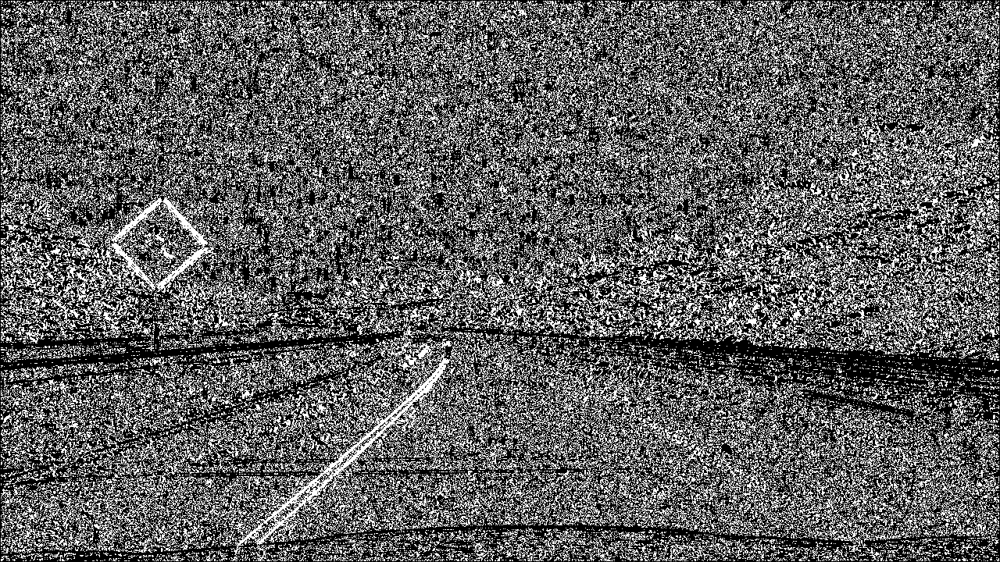

In [310]:
## Interactive version for tuning threshold parameters (only works while running Jupyter Notebook)

@interact
def dir_thresh_image(image:fixed(undist), sobel_kernel:(3,21,2)=3, 
                     dir_min:(0.,np.pi/2,0.05)=0.6, dir_max:(0,np.pi/2,0.05)=1.0):
  
    dir_binary = dir_threshold(img, sobel_kernel, thresh=(dir_min, dir_max))
    
    return show_interactive(dir_binary)
    

### Display all directional gradients side by side

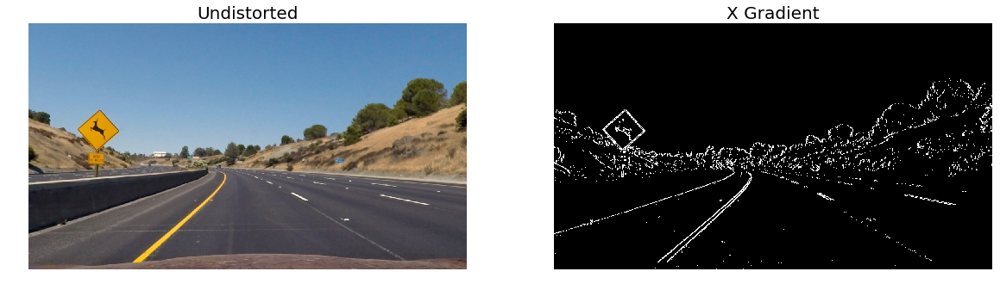

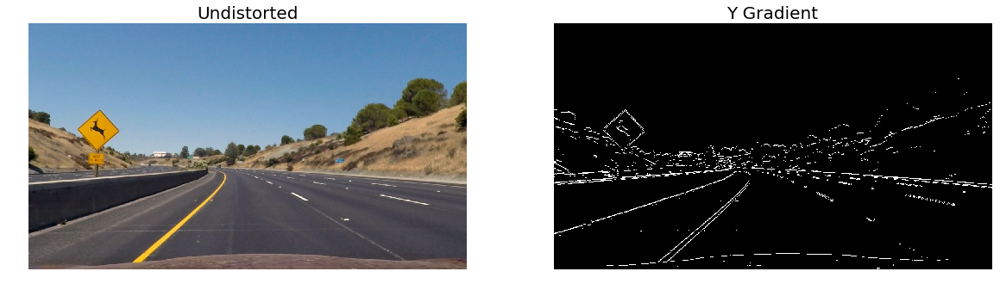

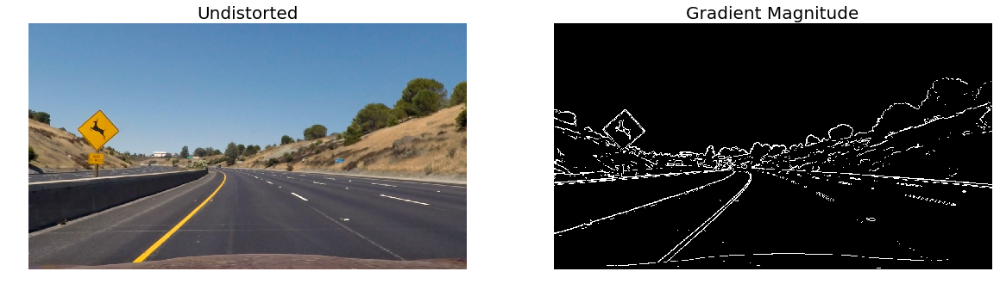

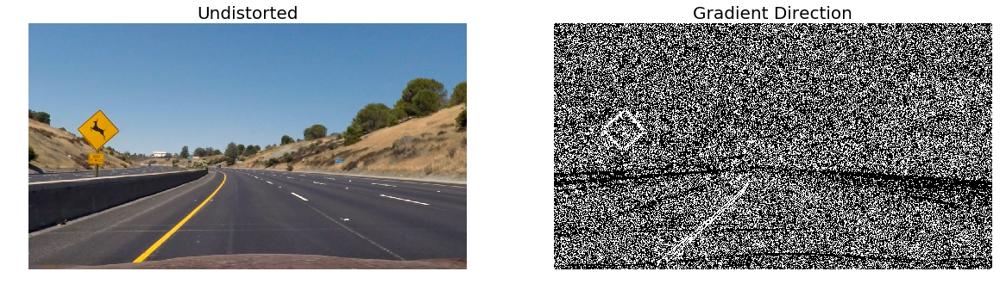

In [403]:
## Display binary outputs next to the undistorted originals

img = test2

# X gradient
sx_binary = abs_thresh(img, orient='x', sobel_kernel=3, thresh=(30,130))
show_RGB(undist, sx_binary, title2='X Gradient') 

# Y gradient
sy_binary = abs_thresh(img, orient='y', sobel_kernel=3, thresh=(50,140))
show_RGB(undist, sy_binary, title2='Y Gradient') 

# Magnitude
mag_binary = mag_thresh(img, sobel_kernel=5, thresh=(50,150))
show_RGB(undist, mag_binary, title2='Gradient Magnitude')

# Gradient direction
dir_binary = dir_thresh(img, sobel_kernel=3, thresh=(0.4, 1.1))
show_RGB(undist, dir_binary, title2='Gradient Direction') 

### Combine the Most Useful Thresholds
In this case, we take the union of the X gradient, Y gradient, and their magnitude.

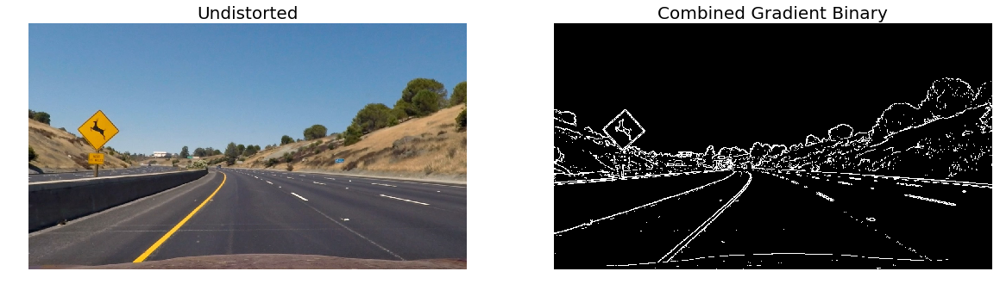

In [341]:
comb_grad_binary = np.zeros_like(sx_binary)
comb_grad_binary[((sx_binary == 1) | (sy_binary == 1)) | (mag_binary == 1)] = 1
show_RGB(test2, comb_grad_binary, title2='Combined Gradient Binary') 

---
## Step 3.2 | Color Thresholds
In this section we explore different thresholds by isolating specific color channels within the image.

&nbsp;
### Grayscale

In [129]:
def gray_thresh(img, thresh=(0, 255)):
    
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Create binary mask based on thresholds
    gray_binary = np.zeros_like(gray)
    gray_binary[(gray > thresh[0]) & (gray <= thresh[1])] = 1
    
    return gray_binary

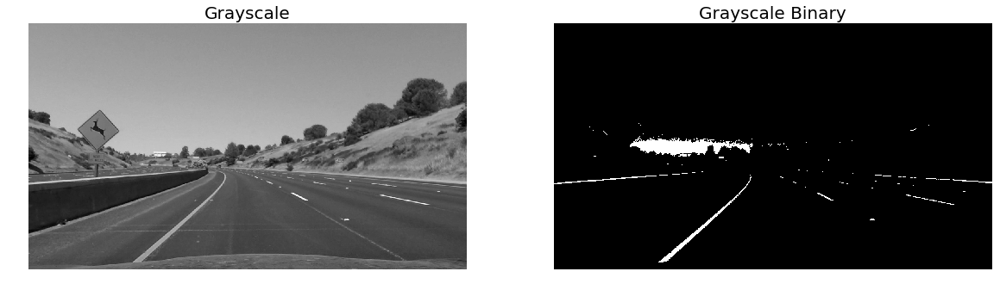

In [336]:
img = test2
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
gray_binary = gray_thresh(img, thresh=(182, 255))
show_RGB(gray, gray_binary, chan1='gray', title1='Grayscale', title2='Grayscale Binary') 

&nbsp;
### Contrast Limited Adaptive Histogram Equalization (CLAHE)
I had some success using this approach in [Project 2: Identifying Traffic Signs](https://github.com/tommytracey/udacity/tree/master/self-driving-nano/projects/2-traffic-signs#data-preprocessing). So, I'm experimenting with it again here on this project, although this time I'm using the [OpenCV method](http://docs.opencv.org/3.1.0/d6/dc7/group__imgproc__hist.html#ga7e54091f0c937d49bf84152a16f76d6e) instead of the [Scikit method](http://scikit-image.org/docs/dev/api/skimage.exposure.html#skimage.exposure.equalize_adapthist). I'm also customizing the approach by applying smoothing just prior to the CLAHE. This seemed to be an effective strategy for removing noise in both project 1 and project 3. 

More information explaning this method is available [here in the OpenCV docs](http://docs.opencv.org/3.1.0/d5/daf/tutorial_py_histogram_equalization.html).

In [375]:
# CLAHE threshold function

def clahe_thresh(img, thresh=182):
    '''Applies the Contrast Limited Adaptive Histogram Equalization (CLAHE) algorithm.  
    '''
    
    # Convert to grayscale
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY).astype(np.uint8)
    
    # Apply smoothing
    img = cv2.medianBlur(img, 3)
    
    # Apply CLAHE
    img = cv2.equalizeHist(img)
    
    # Apply threshold and create binary
    ret, clahe_binary = cv2.threshold(img, thresh=thresh, maxval=255, type=cv2.THRESH_BINARY)

    return clahe_binary

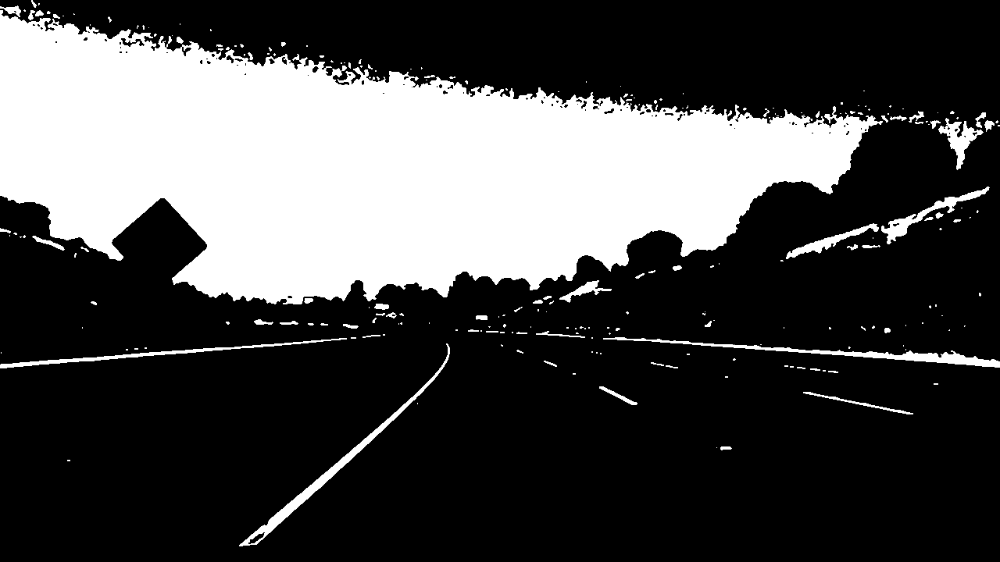

In [376]:
## Interactive version for tuning threshold parameters (only works while running Jupyter Notebook)

img = test2

@interact
def clahe_thresh_image(image: fixed(undist), thresh:(0,255)=182):
  
    clahe_binary = clahe_thresh(img, thresh)
    
    return show_interactive(clahe_binary)
    

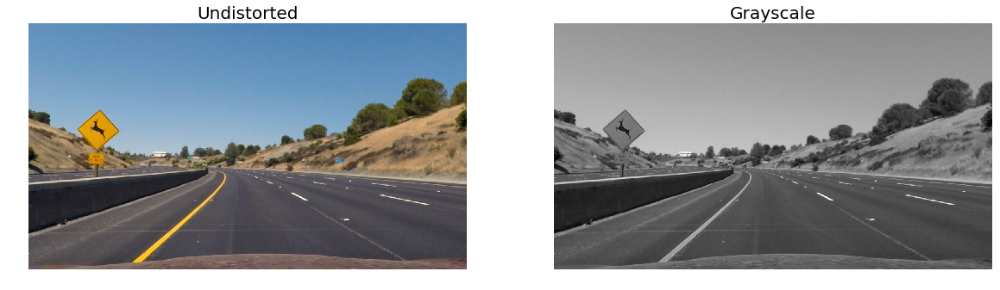

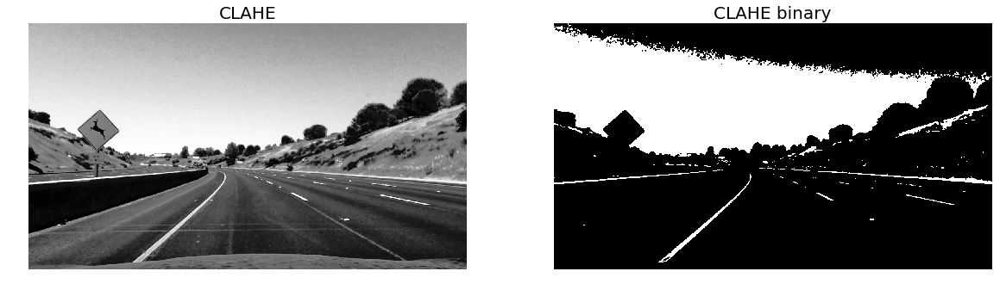

In [377]:
# Show CLAHE and its binary mask side-by-side

gray = cv2.cvtColor(undist, cv2.COLOR_RGB2GRAY)
clahe = cv2.equalizeHist(gray)
clahe_binary = clahe_thresh(undist, thresh=182)

show_RGB(undist, gray, title2='Grayscale')
show_RGB(clahe, clahe_binary, chan1='gray', title1='CLAHE', title2='CLAHE binary') 

#### CONCLUSION:
Again the CLAHE has proven effective. It's a noticeable improvement over using grayscale alone. We'll see how it compares with other approaches in the following section, but this definitely seems like it could be part of the final thresholding solution.

&nbsp;
### More Challenging Test Images
So far, the methods above appear effective at identifying lane lines under fairly optimal driving conditions (i.e. clear lane markings, no shadows, no glare, consistent pavement color, etc). Now let's see how well these methods perform on a more challenging set of test images. 

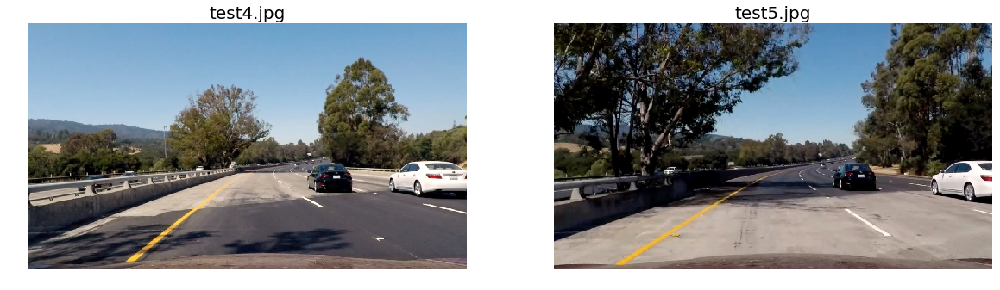

In [339]:
show_RGB(test4, test5, chan1='BGR', chan2='BGR', title1='test4.jpg', title2='test5.jpg')

#### Results for test4.jpg

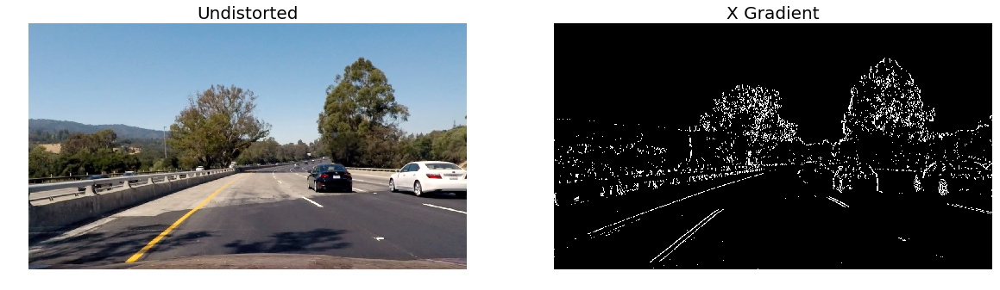

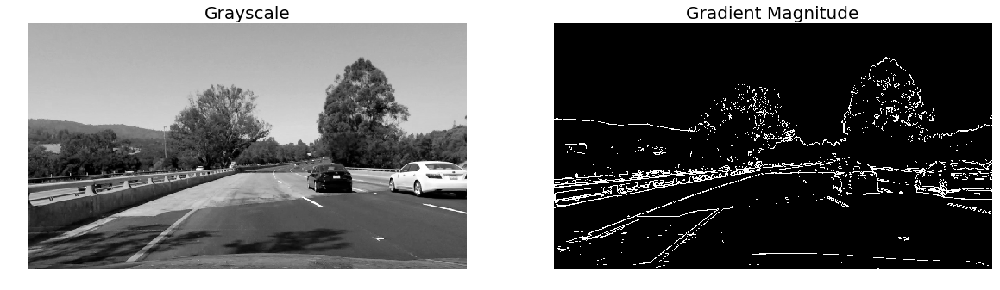

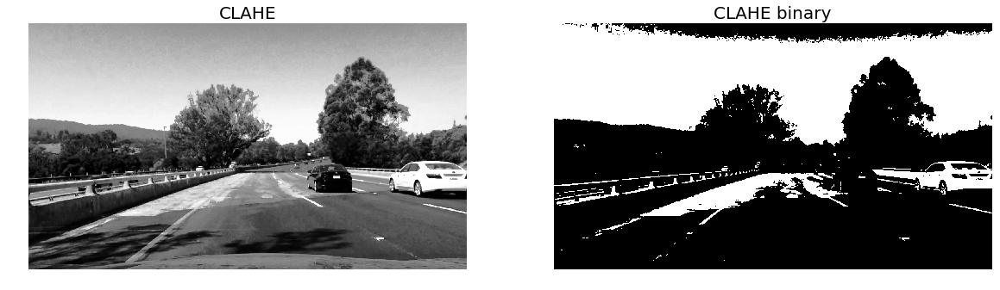

In [145]:
## Display binary outputs next to the undistorted originals

# X gradient
sx_binary = abs_thresh(test4, orient='x', sobel_kernel=3, thresh=(30,130))

# Magnitude
mag_binary = mag_thresh(test4, sobel_kernel=5, thresh=(50,150))

# CLAHE
gray = cv2.cvtColor(test4, cv2.COLOR_RGB2GRAY)
clahe = cv2.equalizeHist(gray)
clahe_binary = clahe_thresh(test4, thresh=160)

# Visualize results
show_RGB(test4, sx_binary, chan2='gray', title2='X Gradient')
show_RGB(gray, mag_binary, chan1='gray', chan2='gray', title1='Grayscale', title2='Gradient Magnitude')
show_RGB(clahe, clahe_binary, chan1='gray', chan2='gray', title1='CLAHE', title2='CLAHE binary') 


#### Results for test5.jpg

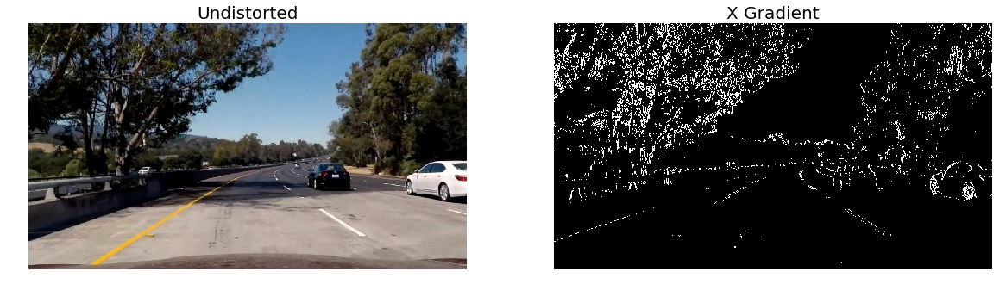

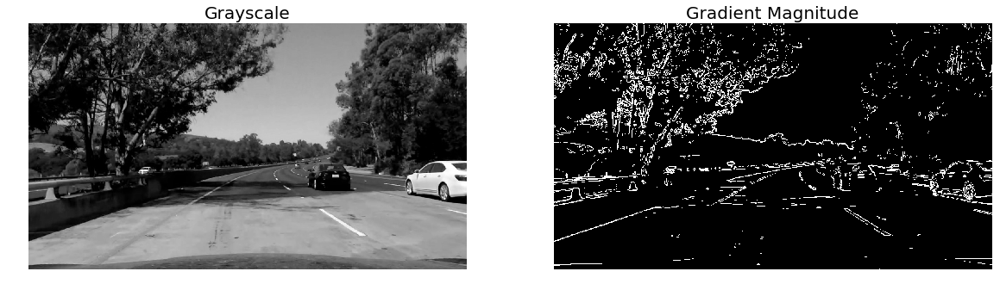

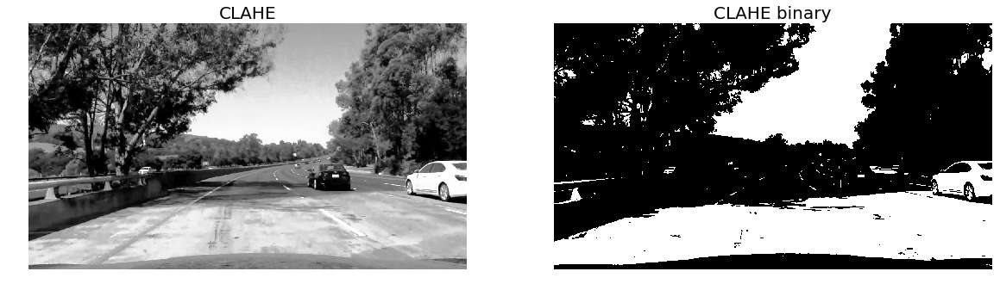

In [147]:
## Display binary outputs next to the undistorted originals

# X gradient
sx_binary = abs_thresh(test5, orient='x', sobel_kernel=3, thresh=(30,130))

# Magnitude
mag_binary = mag_thresh(test5, sobel_kernel=5, thresh=(50,150))

# CLAHE
gray = cv2.cvtColor(test5, cv2.COLOR_RGB2GRAY)
clahe = cv2.equalizeHist(gray)
clahe_binary = clahe_thresh(test5, thresh=160)

# Visualize results
show_RGB(test5, sx_binary, chan2='gray', title2='X Gradient')
show_RGB(gray, mag_binary, chan1='gray', chan2='gray', title1='Grayscale', title2='Gradient Magnitude')
show_RGB(clahe, clahe_binary, chan1='gray', chan2='gray', title1='CLAHE', title2='CLAHE binary') 


#### CONCLUSION:
Clearly the thresholding methods that worked on the optimal stretches of road will NOT work across all types of driving conditions. The lane lines are almost completely undetectable in the more challenging test images. So, we need to keep experimenting, while using the challenge images as our testing baseline. 

&nbsp;
### Red, Green, Blue (RGB) Color Channels

In [170]:
def rgb_thresh(img, channel='R', thresh=(200, 255)):
    
    # Split the image into its color channels
    R, G, B = img[:,:,2], img[:,:,1], img[:,:,0]
    
    # Select the channel to use
    if channel == 'R':
        channel = R
    elif channel == 'G':
        channel = G
    elif channel == 'B':
        channel = B
    else:
        raise ValueError("Channel not recognized. Only RGB channels can be displayed as binaries.")
    
    # Create binary mask using the chosen channel
    rgb_binary = np.zeros_like(channel)
    rgb_binary[(channel > thresh[0]) & (channel <= thresh[1])] = 1
    
    return rgb_binary

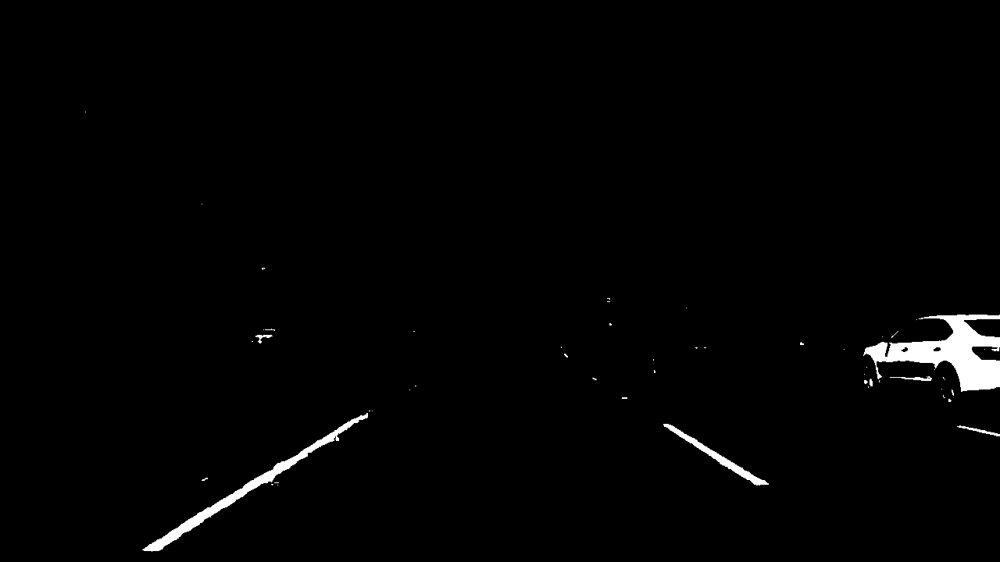

In [294]:
## Interactive version for tuning threshold parameters (only works while running Jupyter Notebook)

# Select test image
img = test5

@interact
def rgb_thresh_image(image: fixed(img), channel:('R','G','B')='R', thresh_min:(0,255)=225, thresh_max:(0,255)=255):
  
    rgb_binary = rgb_thresh(image, channel, thresh=(thresh_min, thresh_max))
    
    return show_interactive(rgb_binary)
    

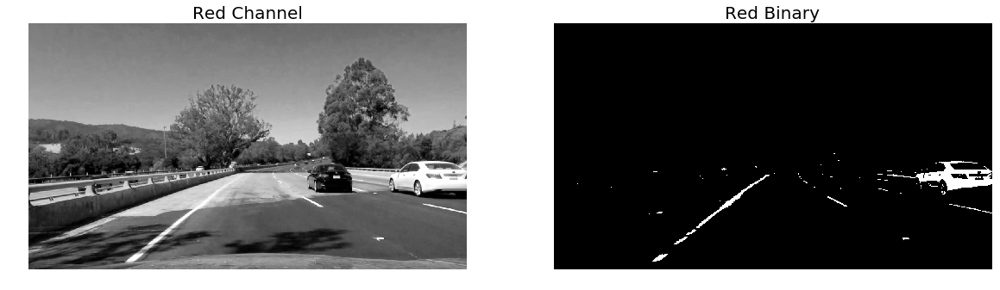

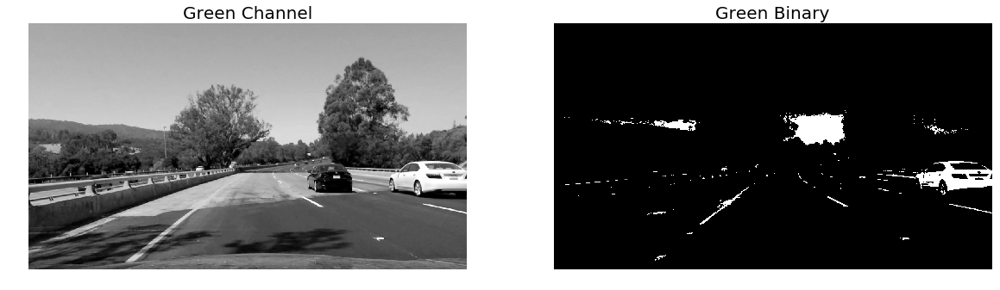

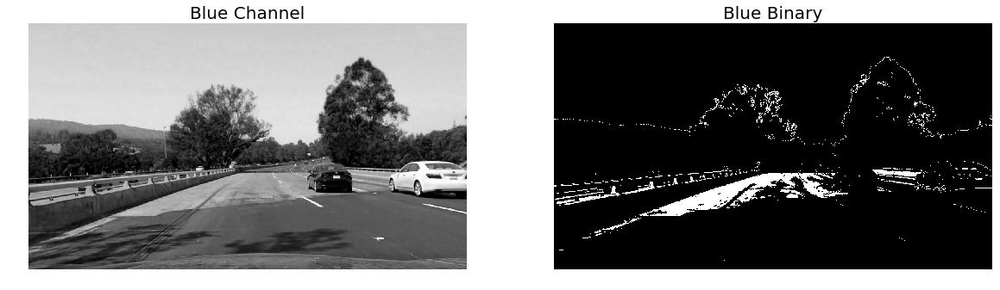

In [173]:
## Show channels and binaries side-by-side

img = test4

# Manually extract RGB channels for display comparison with binaries
R, G, B = img[:,:,2], img[:,:,1], img[:,:,0]  # note the channel order is flipped from cv2.imread's BGR output

# Create binaries
r_binary = rgb_thresh(img, channel='R', thresh=(225,255))
g_binary = rgb_thresh(img, channel='G', thresh=(205,255))
b_binary = rgb_thresh(img, channel='B', thresh=(160,187))

# Visualize results
show_RGB(R, r_binary, chan1='gray', chan2='gray', title1='Red Channel', title2='Red Binary')
show_RGB(G, g_binary, chan1='gray', chan2='gray', title1='Green Channel', title2='Green Binary')
show_RGB(B, b_binary, chan1='gray', chan2='gray', title1='Blue Channel', title2='Blue Binary')

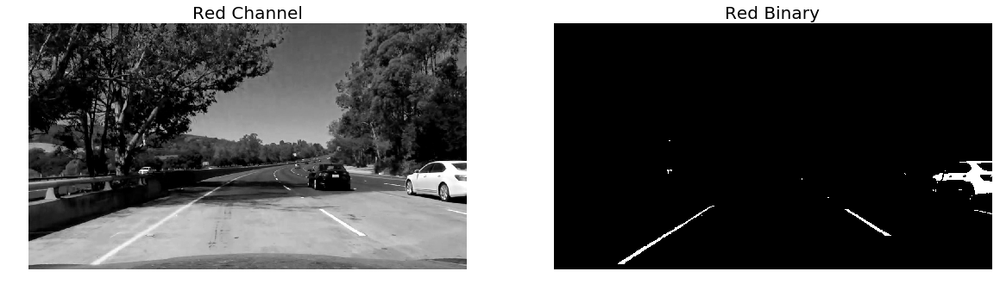

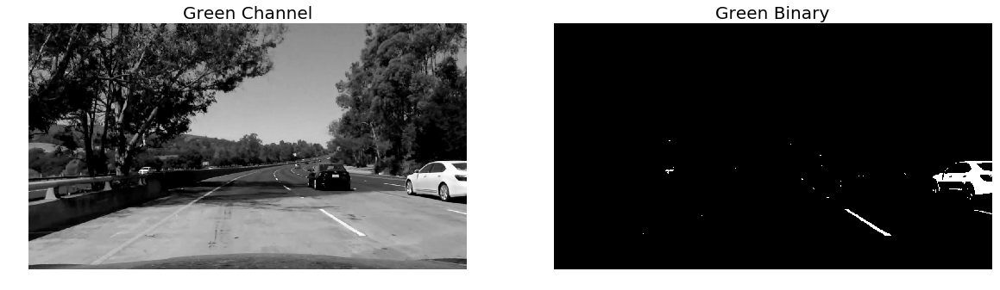

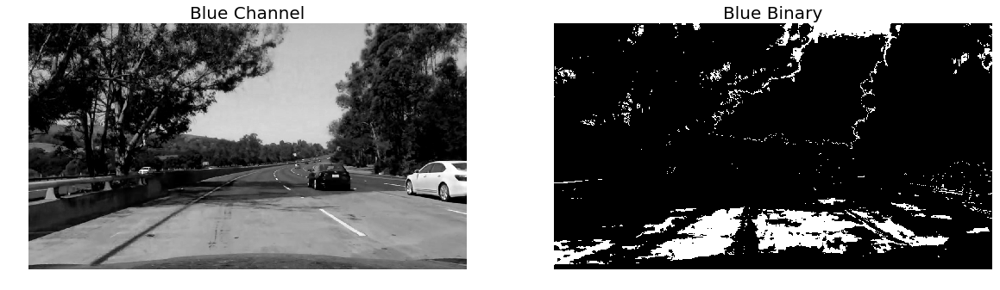

In [295]:
## Show channels and binaries side-by-side

img = test5

# Manually extract RGB channels for display comparison with binaries
R, G, B = img[:,:,2], img[:,:,1], img[:,:,0]  # note the channel order is flipped from cv2.imread's BGR output

# Create binaries
r_binary = rgb_thresh(img, channel='R', thresh=(225,255))
g_binary = rgb_thresh(img, channel='G', thresh=(205,255))
b_binary = rgb_thresh(img, channel='B', thresh=(160,187))

# Visualize results
show_RGB(R, r_binary, chan1='gray', chan2='gray', title1='Red Channel', title2='Red Binary')
show_RGB(G, g_binary, chan1='gray', chan2='gray', title1='Green Channel', title2='Green Binary')
show_RGB(B, b_binary, chan1='gray', chan2='gray', title1='Blue Channel', title2='Blue Binary')

#### CONCLUSION:
The red color channel might prove useful, but most likely the green and blue channels will not. 

#### &nbsp;
### HLS (Hue, Lightness, Saturation) Color Channels

In [191]:
def hls_thresh(img, channel='S', thresh=(200, 255)):
    
    # Convert to HLS
    hls = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)
    
    # Split the image into its color channels
    H, L, S = hls[:,:,0], hls[:,:,1], hls[:,:,2]
    
    # Select the channel to use
    if channel == 'H':
        channel = H
    elif channel == 'L':
        channel = L
    elif channel == 'S':
        channel = S
    else:
        raise ValueError("Channel not recognized. Only HLS channels can be displayed as binaries.")
    
    # Create binary mask using the chosen channel
    hls_binary = np.zeros_like(channel)
    hls_binary[(channel > thresh[0]) & (channel <= thresh[1])] = 1
    
    return hls_binary

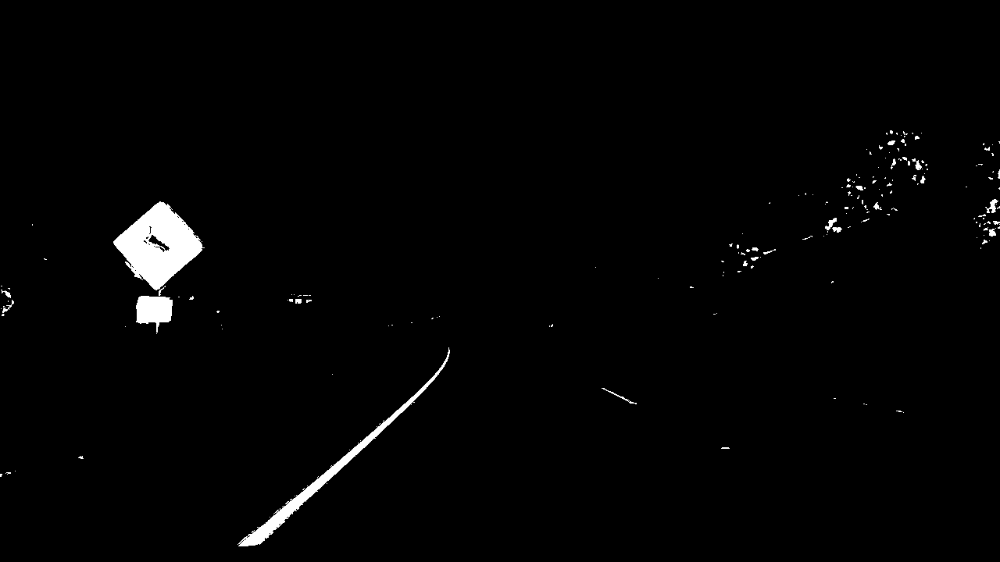

In [201]:
## Interactive version for tuning threshold parameters (only works while running Jupyter Notebook)

# Select test image
img = test2

@interact
def hls_thresh_image(image: fixed(img), channel:('H','L','S')='S', thresh_min:(0,255)=150, thresh_max:(0,255)=255):
  
    hls_binary = hls_thresh(image, channel, thresh=(thresh_min, thresh_max))
    
    return show_interactive(hls_binary)
    

#### Test HLS on simple image

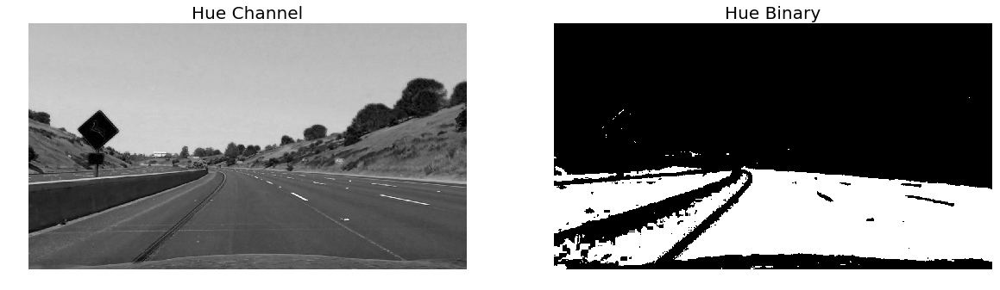

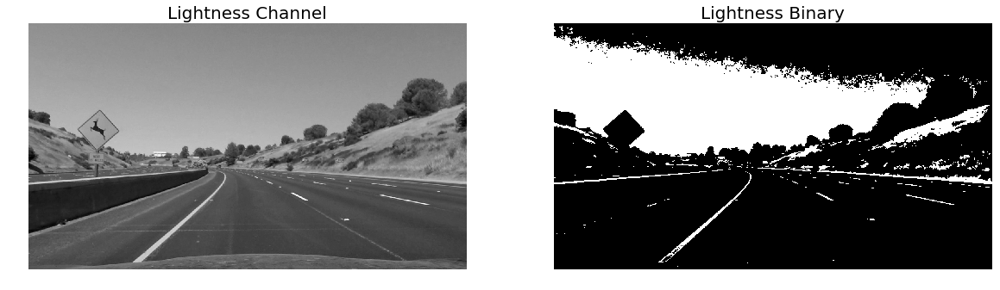

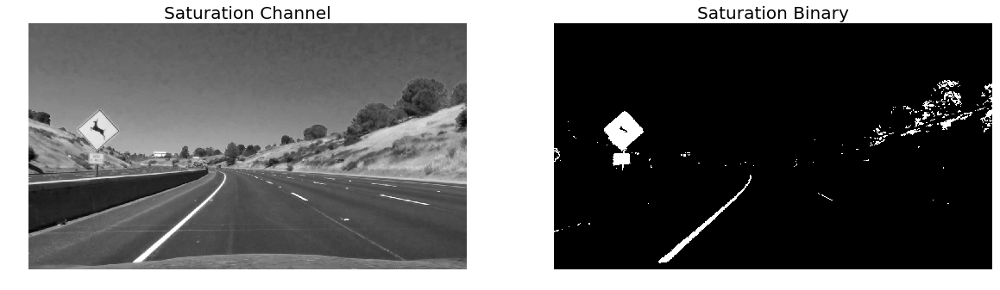

In [197]:
## Show channels and binaries side-by-side

img = test2

# Manually extract HLS channels for display comparison with binaries
H, L, S = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
h_binary = hls_thresh(img, channel='H', thresh=(107,255))
l_binary = hls_thresh(img, channel='L', thresh=(145,255))
s_binary = hls_thresh(img, channel='S', thresh=(120,255))

# Visualize results
show_RGB(H, h_binary, chan1='gray', chan2='gray', title1='Hue Channel', title2='Hue Binary')
show_RGB(L, l_binary, chan1='gray', chan2='gray', title1='Lightness Channel', title2='Lightness Binary')
show_RGB(S, s_binary, chan1='gray', chan2='gray', title1='Saturation Channel', title2='Saturation Binary')

#### Test HLS on challenge images

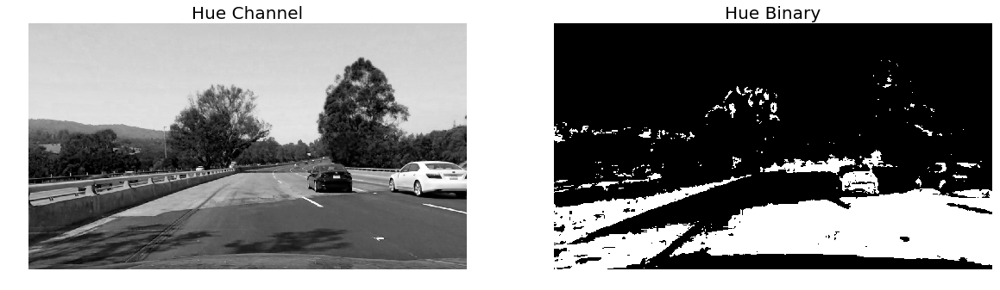

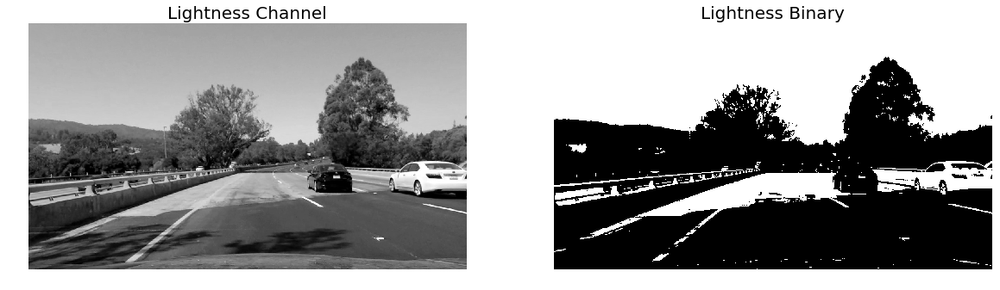

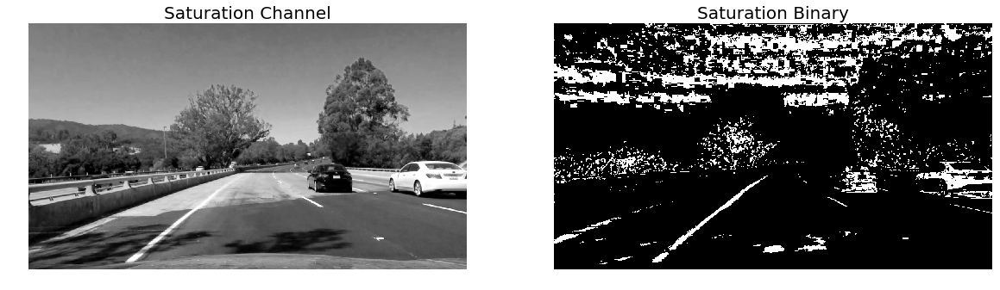

In [198]:
## Show channels and binaries side-by-side

img = test4

# Manually extract HLS channels for display comparison with binaries
H, L, S = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
h_binary = hls_thresh(img, channel='H', thresh=(107,255))
l_binary = hls_thresh(img, channel='L', thresh=(145,255))
s_binary = hls_thresh(img, channel='S', thresh=(120,255))

# Visualize results
show_RGB(H, h_binary, chan1='gray', chan2='gray', title1='Hue Channel', title2='Hue Binary')
show_RGB(L, l_binary, chan1='gray', chan2='gray', title1='Lightness Channel', title2='Lightness Binary')
show_RGB(S, s_binary, chan1='gray', chan2='gray', title1='Saturation Channel', title2='Saturation Binary')

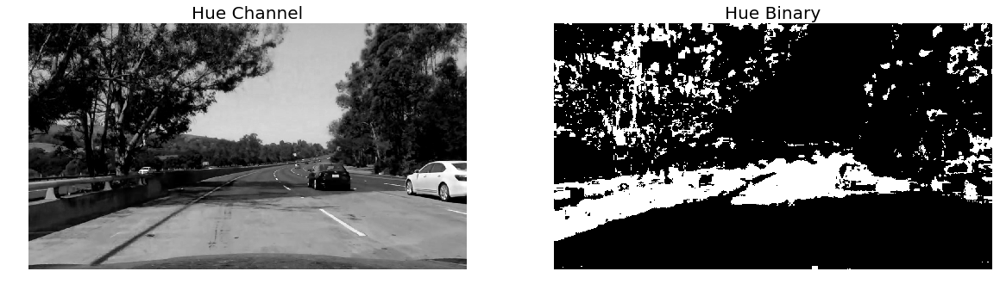

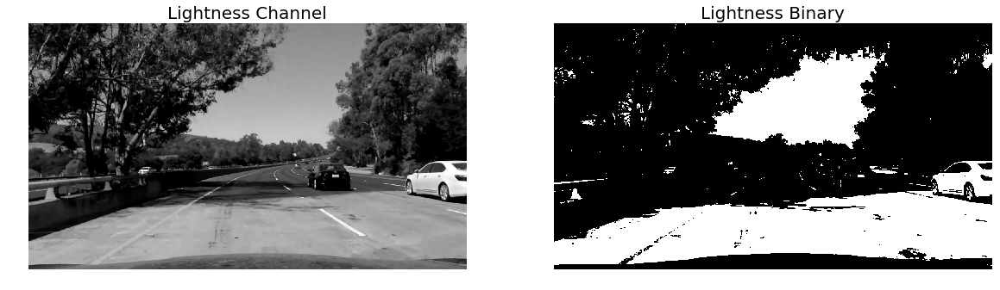

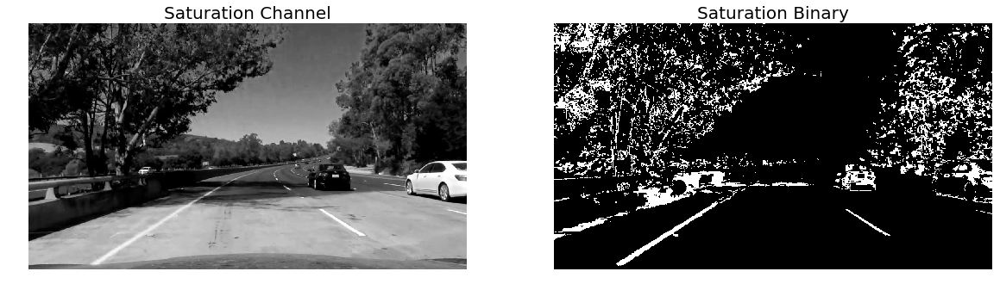

In [199]:
## Show channels and binaries side-by-side

img = test5

# Manually extract HLS channels for display comparison with binaries
H, L, S = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
h_binary = hls_thresh(img, channel='H', thresh=(107,255))
l_binary = hls_thresh(img, channel='L', thresh=(145,255))
s_binary = hls_thresh(img, channel='S', thresh=(120,255))

# Visualize results
show_RGB(H, h_binary, chan1='gray', chan2='gray', title1='Hue Channel', title2='Hue Binary')
show_RGB(L, l_binary, chan1='gray', chan2='gray', title1='Lightness Channel', title2='Lightness Binary')
show_RGB(S, s_binary, chan1='gray', chan2='gray', title1='Saturation Channel', title2='Saturation Binary')

#### CONCLUSION:
While all three of the HLS channels seem to work to varying degrees on the simple image, only the saturation channel (S) is versatile enough to work on both simple and challenging images. Although the S channel still seems to struggle with shadows, overall it's the best filter so far and is probably worth using as part of the final solution.

#### &nbsp;
### HSV (Hue, Saturation, Value) Color Channels

In [202]:
def hsv_thresh(img, channel='S', thresh=(200, 255)):
    
    # Convert to HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # Split the image into its color channels
    H, S, V = hsv[:,:,0], hsv[:,:,1], hsv[:,:,2]
    
    # Select the channel to use
    if channel == 'H':
        channel = H
    elif channel == 'S':
        channel = S
    elif channel == 'V':
        channel = V
    else:
        raise ValueError("Channel not recognized. Only HSV channels can be displayed as binaries.")
    
    # Create binary mask using the chosen channel
    hsv_binary = np.zeros_like(channel)
    hsv_binary[(channel > thresh[0]) & (channel <= thresh[1])] = 1
    
    return hsv_binary

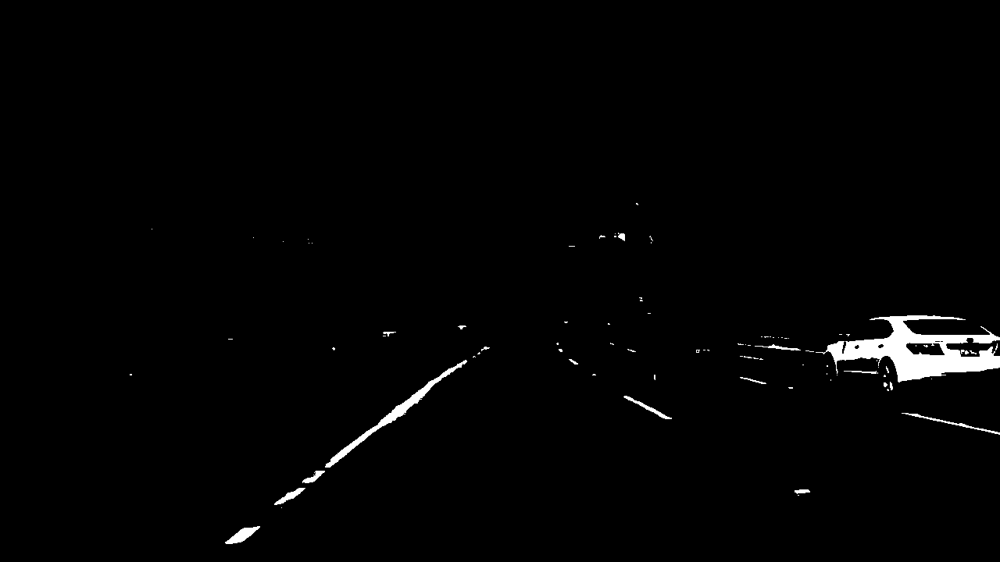

In [385]:
## Interactive version for tuning threshold parameters (only works while running Jupyter Notebook)

# Select test image
img = test4

@interact
def hsv_thresh_image(image: fixed(img), channel:('H','S','V')='V', thresh_min:(0,255)=196, thresh_max:(0,255)=255):
  
    hsv_binary = hsv_thresh(image, channel, thresh=(thresh_min, thresh_max))
    
    return show_interactive(hsv_binary)
    

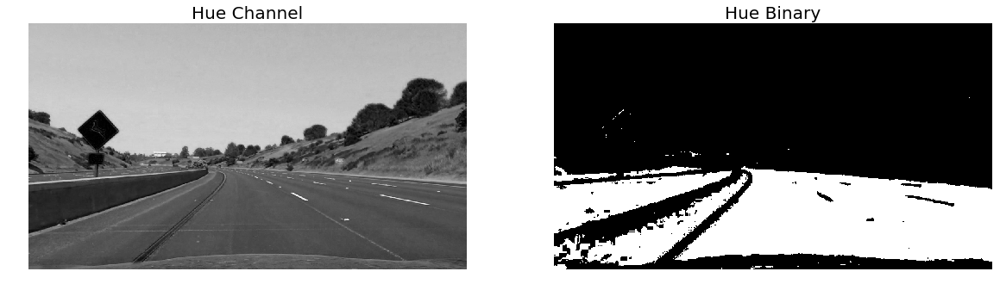

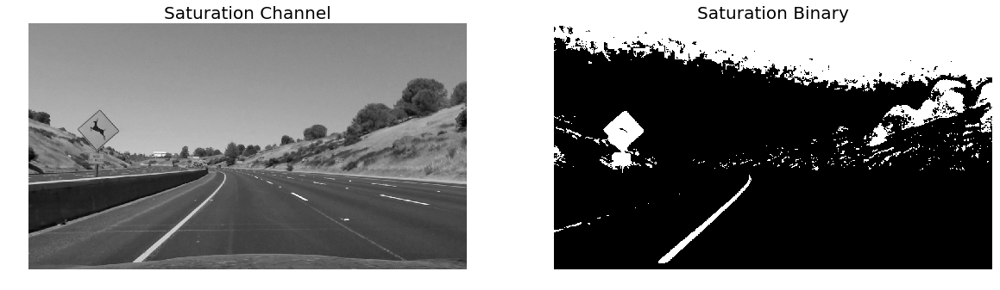

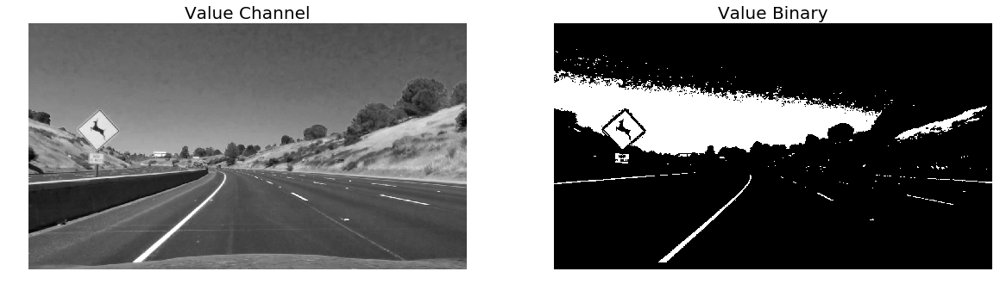

In [205]:
## Show channels and binaries side-by-side

img = test2

# Manually extract HSV channels for display comparison with binaries
H, S, V = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
h_binary = hsv_thresh(img, channel='H', thresh=(107,255))
s_binary = hsv_thresh(img, channel='S', thresh=(120,255))
v_binary = hsv_thresh(img, channel='V', thresh=(196,255))

# Visualize results
show_RGB(H, h_binary, chan1='gray', chan2='gray', title1='Hue Channel', title2='Hue Binary')
show_RGB(S, s_binary, chan1='gray', chan2='gray', title1='Saturation Channel', title2='Saturation Binary')
show_RGB(V, v_binary, chan1='gray', chan2='gray', title1='Value Channel', title2='Value Binary')

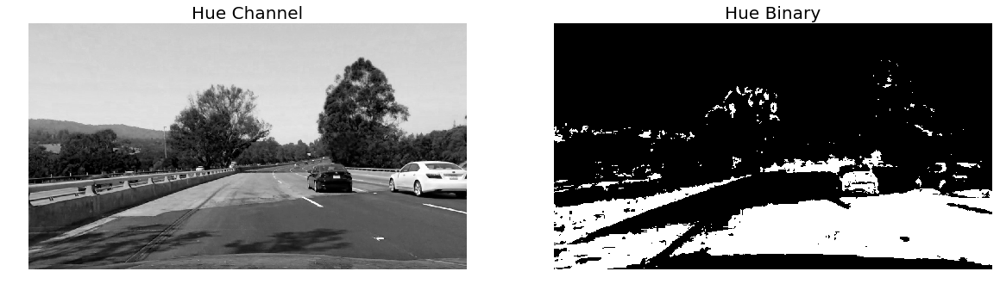

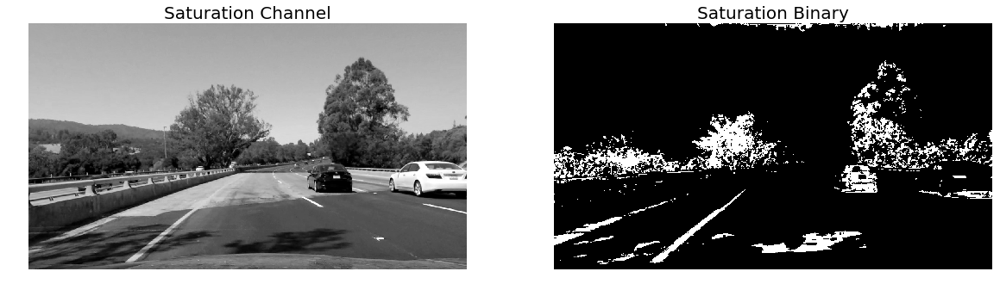

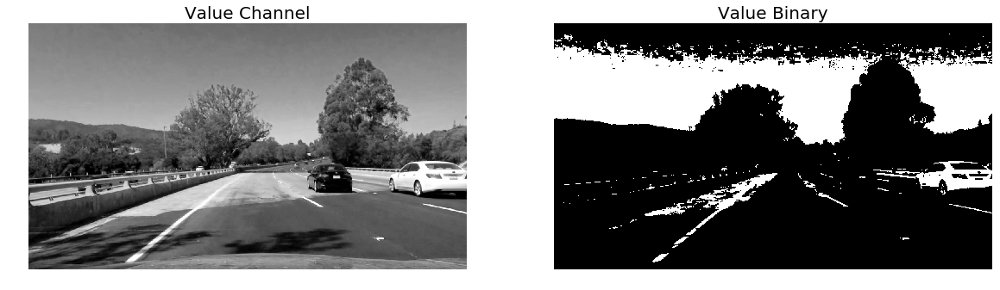

In [212]:
## Show channels and binaries side-by-side

img = test4

# Manually extract HSV channels for display comparison with binaries
H, S, V = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
h_binary = hsv_thresh(img, channel='H', thresh=(107,255))
s_binary = hsv_thresh(img, channel='S', thresh=(120,255))
v_binary = hsv_thresh(img, channel='V', thresh=(209,255))

# Visualize results
show_RGB(H, h_binary, chan1='gray', chan2='gray', title1='Hue Channel', title2='Hue Binary')
show_RGB(S, s_binary, chan1='gray', chan2='gray', title1='Saturation Channel', title2='Saturation Binary')
show_RGB(V, v_binary, chan1='gray', chan2='gray', title1='Value Channel', title2='Value Binary')

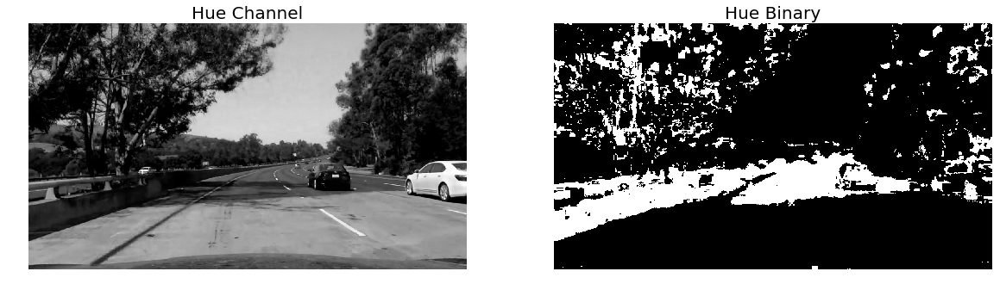

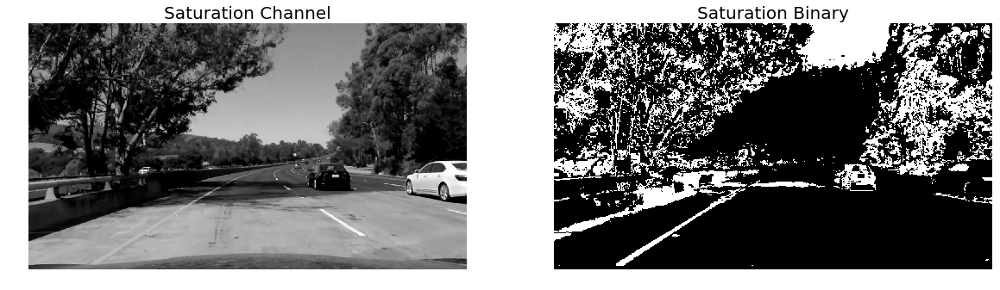

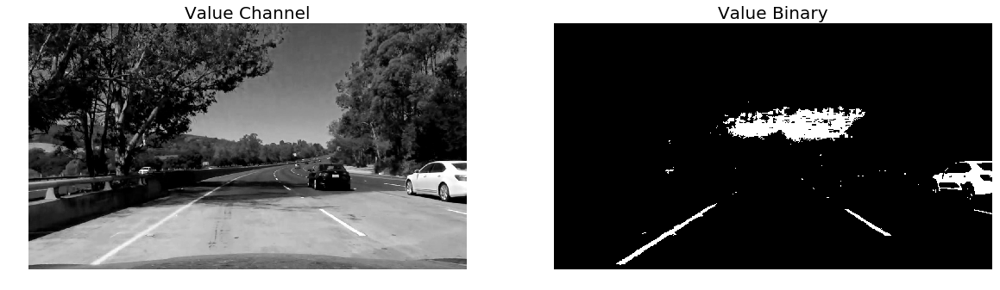

In [296]:
## Show channels and binaries side-by-side

img = test5

# Manually extract HSV channels for display comparison with binaries
H, S, V = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
h_binary = hsv_thresh(img, channel='H', thresh=(107,255))
s_binary = hsv_thresh(img, channel='S', thresh=(120,255))
v_binary = hsv_thresh(img, channel='V', thresh=(209,255))

# Visualize results
show_RGB(H, h_binary, chan1='gray', chan2='gray', title1='Hue Channel', title2='Hue Binary')
show_RGB(S, s_binary, chan1='gray', chan2='gray', title1='Saturation Channel', title2='Saturation Binary')
show_RGB(V, v_binary, chan1='gray', chan2='gray', title1='Value Channel', title2='Value Binary')

#### CONCLUSION:
It appears the value (V) channel in the HSV color space does a really nice job of identifying lane lines under optimal driving conditions. It actually does a better job identifying the inside white lanes than the saturation (S) channel. However, the V channel does not perform as well as the S channel when confronted with shadows or low contrast pavement. Therefore, it seems that the S and V channels compliment each other and are likey to be part of the final solution.

#### &nbsp;
### YUV (luma and chrominance) Color Channels

In [214]:
def yuv_thresh(img, channel='Y', thresh=(150, 255)):
    
    # Convert to YUV
    yuv = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)
    
    # Split the image into its color channels
    Y, U, V = yuv[:,:,0], yuv[:,:,1], yuv[:,:,2]
    
    # Select the channel to use
    if channel == 'Y':
        channel = Y
    elif channel == 'U':
        channel = U
    elif channel == 'V':
        channel = V
    else:
        raise ValueError("Channel not recognized. Only YUV channels can be displayed as binaries.")
    
    # Create binary mask using the chosen channel
    yuv_binary = np.zeros_like(channel)
    yuv_binary[(channel > thresh[0]) & (channel <= thresh[1])] = 1
    
    return yuv_binary

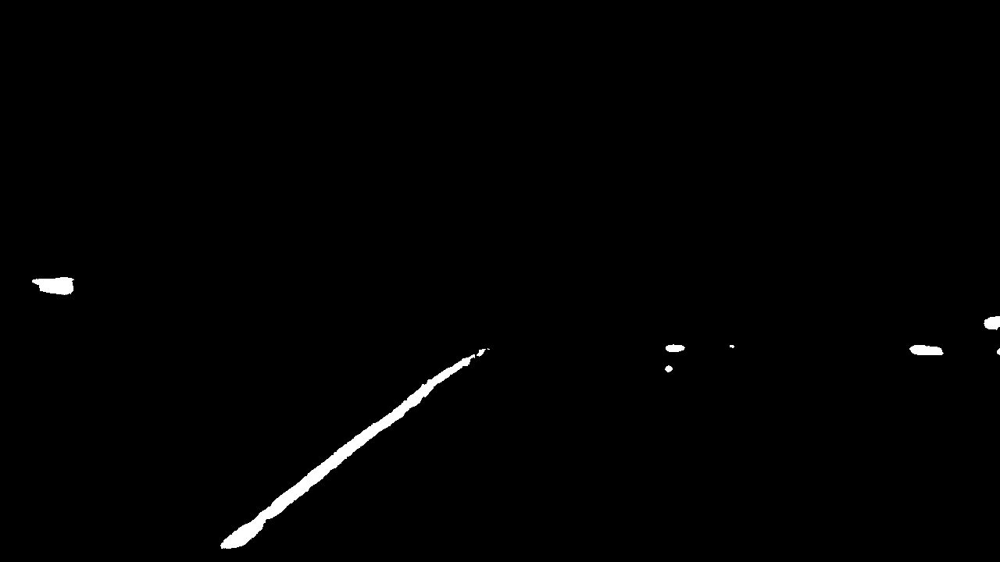

In [220]:
## Interactive version for tuning threshold parameters (only works while running Jupyter Notebook)

# Select test image
img = test4

@interact
def yuv_thresh_image(image: fixed(img), channel:('Y','U','V')='Y', thresh_min:(0,255)=150, thresh_max:(0,255)=255):
  
    yuv_binary = yuv_thresh(image, channel, thresh=(thresh_min, thresh_max))
    
    return show_interactive(yuv_binary)
    

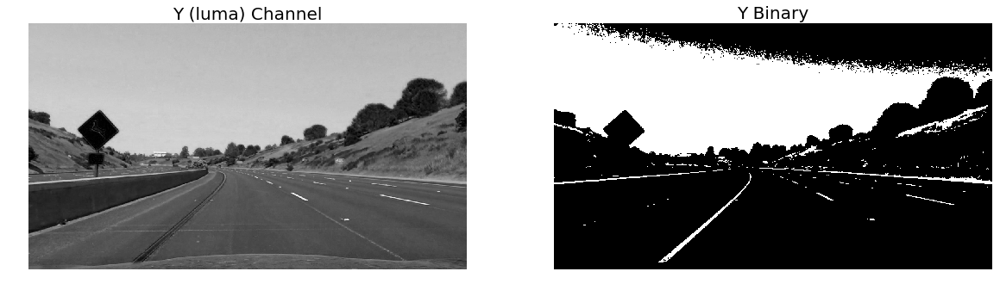

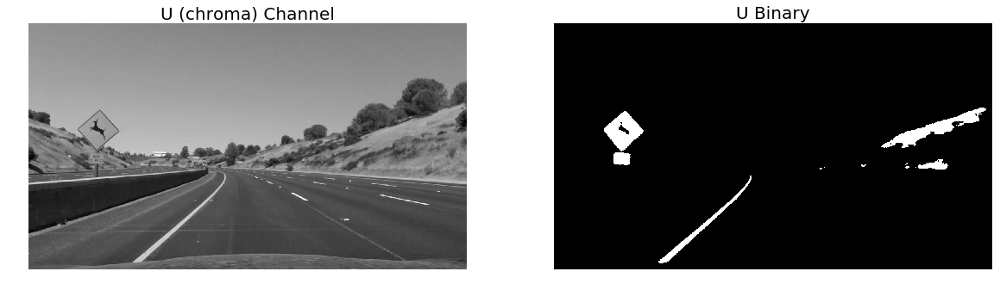

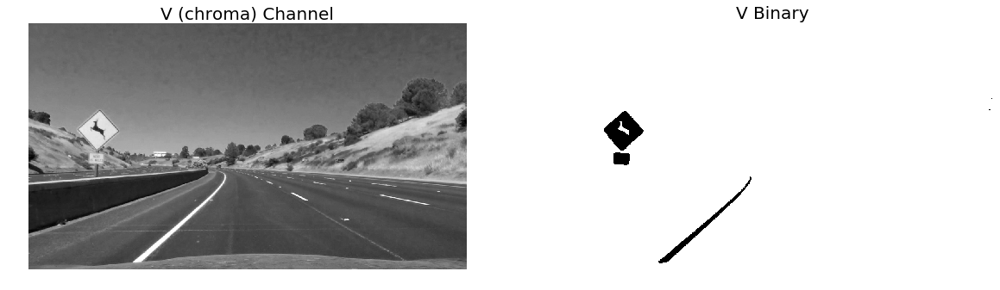

In [217]:
## Vhow channels and binaries side-by-side

img = test2

# Manually extract YUV channels for display comparison with binaries
Y, U, V = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
y_binary = yuv_thresh(img, channel='Y', thresh=(150,255))
u_binary = yuv_thresh(img, channel='U', thresh=(150,255))
v_binary = yuv_thresh(img, channel='V', thresh=(90,255))

# Visualize results
show_RGB(Y, y_binary, chan1='gray', chan2='gray', title1='Y (luma) Channel', title2='Y Binary')
show_RGB(U, u_binary, chan1='gray', chan2='gray', title1='U (chroma) Channel', title2='U Binary')
show_RGB(V, v_binary, chan1='gray', chan2='gray', title1='V (chroma) Channel', title2='V Binary')

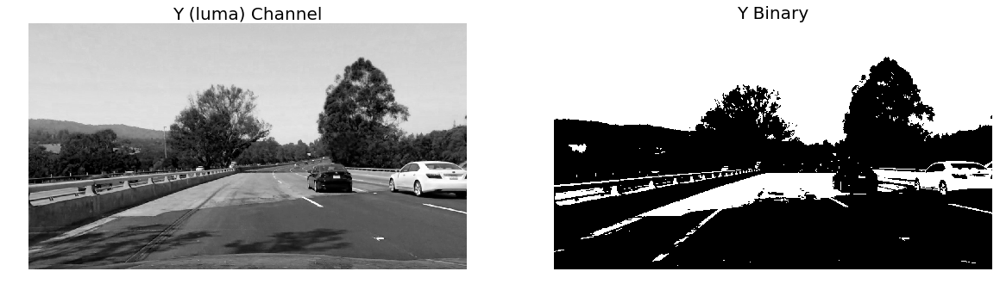

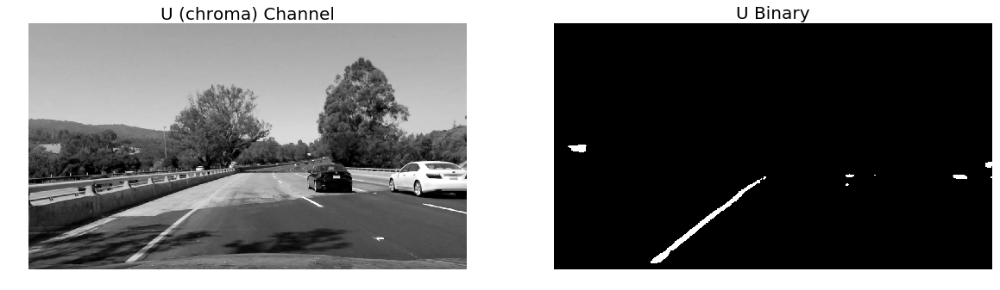

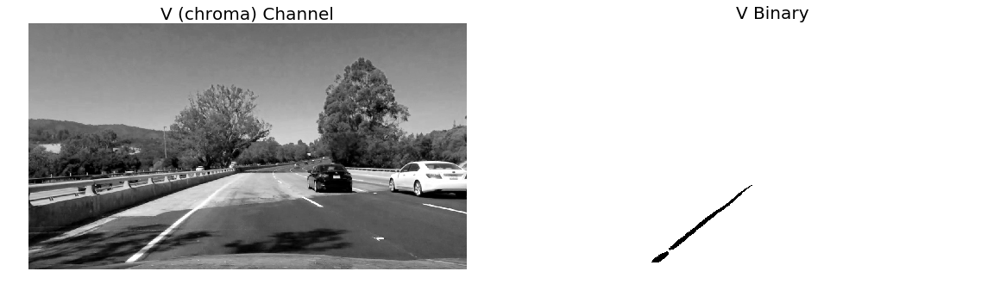

In [298]:
## Vhow channels and binaries side-by-side

img = test4

# Manually extract YUV channels for display comparison with binaries
Y, U, V = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
y_binary = yuv_thresh(img, channel='Y', thresh=(150,255))
u_binary = yuv_thresh(img, channel='U', thresh=(142,255))
v_binary = yuv_thresh(img, channel='V', thresh=(90,255))

# Visualize results
show_RGB(Y, y_binary, chan1='gray', chan2='gray', title1='Y (luma) Channel', title2='Y Binary')
show_RGB(U, u_binary, chan1='gray', chan2='gray', title1='U (chroma) Channel', title2='U Binary')
show_RGB(V, v_binary, chan1='gray', chan2='gray', title1='V (chroma) Channel', title2='V Binary')

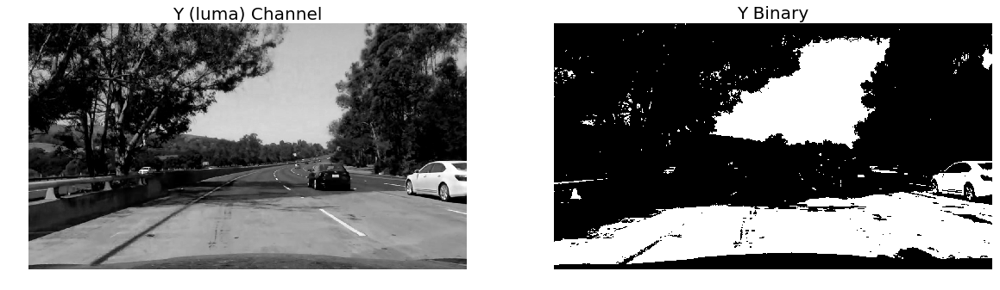

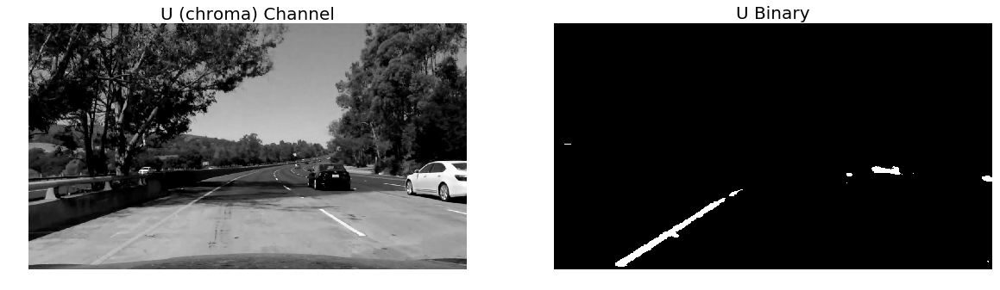

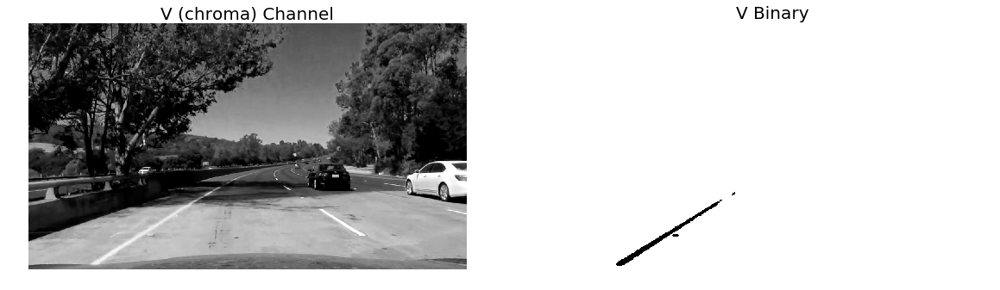

In [299]:
## Vhow channels and binaries side-by-side

img = test5

# Manually extract YUV channels for display comparison with binaries
Y, U, V = img[:,:,0], img[:,:,1], img[:,:,2]

# Create binaries
y_binary = yuv_thresh(img, channel='Y', thresh=(150,255))
u_binary = yuv_thresh(img, channel='U', thresh=(142,255))
v_binary = yuv_thresh(img, channel='V', thresh=(90,255))

# Visualize results
show_RGB(Y, y_binary, chan1='gray', chan2='gray', title1='Y (luma) Channel', title2='Y Binary')
show_RGB(U, u_binary, chan1='gray', chan2='gray', title1='U (chroma) Channel', title2='U Binary')
show_RGB(V, v_binary, chan1='gray', chan2='gray', title1='V (chroma) Channel', title2='V Binary')

#### CONCLUSION:
None of the channels in the YUV color space seem to outperform the saturation (S) channel under challenging conditions. Athought the U channel does a nice job identifying yellow lane lines on light colored pavement. But this benefit is probably not enough to consider it for the final solutions. 

#### &nbsp;
### Test Combinations of Different Thresholds
Here we try to incorporate the best and most complimentary methods into one robust approach for identifying lane lines.

#### Stacking Test
This test shows how different thresholds look when stacked into the same image. This helps to identify which methods are most effective and complimentary.

In [441]:
def stack_thresh(img):
    '''Experiment to see how different thresholds compliment one another when stacked together
    in the same image.'''
    
    # Gradient thresholds
    sx_binary = abs_thresh(img, orient='x', sobel_kernel=3, thresh=(30,130))
    sy_binary = abs_thresh(img, orient='y', sobel_kernel=3, thresh=(50,140))
    mag_binary = mag_thresh(img, sobel_kernel=5, thresh=(50,150))
    
    # Color thresholds
    clahe_binary = clahe_thresh(img)  # contrast limited adaptive hist. equal.
    s_binary = hls_thresh(img, channel='S', thresh=(120,255))  # saturation channel
    v_binary = hsv_thresh(img, channel='V', thresh=(225,255))  # value channel 
    
    # Different stack combinations
    sxy_stack = np.dstack((np.zeros_like(s_binary), sx_binary*255, sy_binary*255))
    sxs_stack = np.dstack((np.zeros_like(s_binary), sx_binary*255, s_binary*255))
    sv_stack = np.dstack((np.zeros_like(s_binary), s_binary*255, v_binary*255))
    cs_stack = np.dstack((np.zeros_like(s_binary), s_binary*255, clahe_binary))
    
    return sxy_stack, sxs_stack, sv_stack, cs_stack

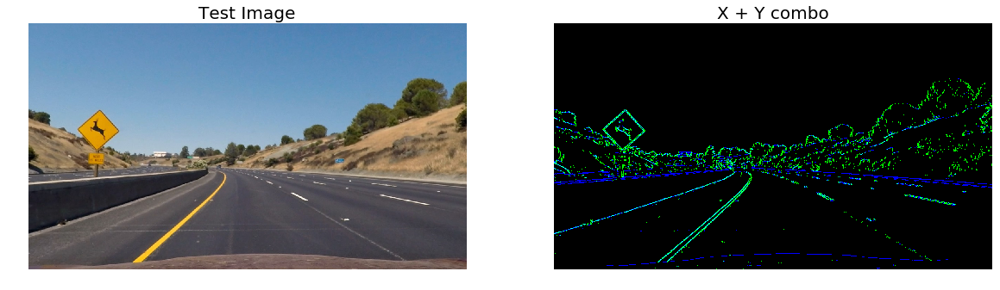

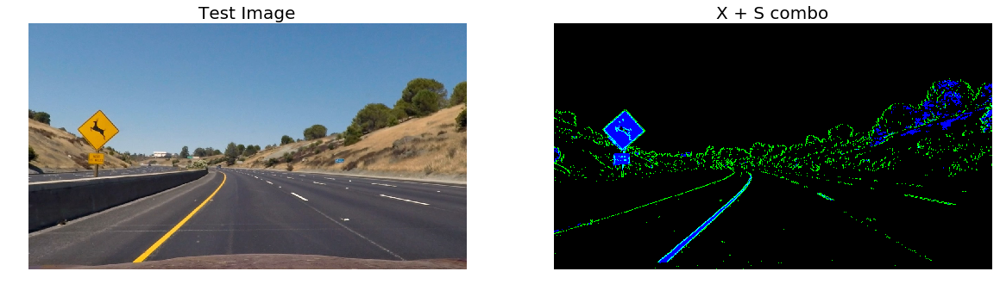

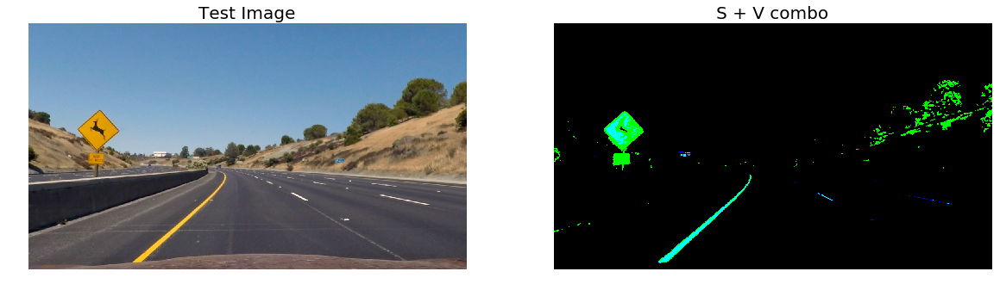

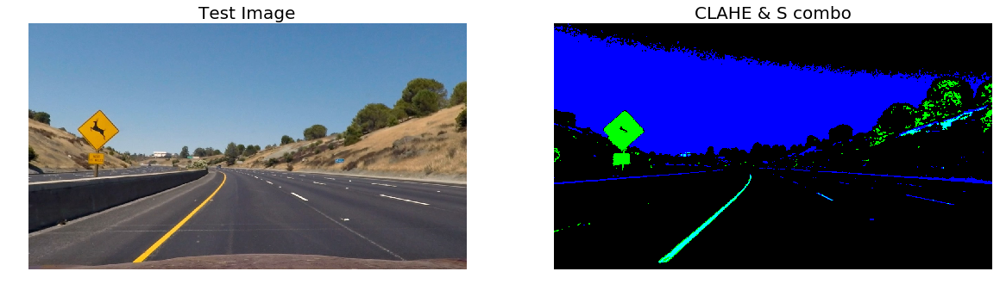

In [444]:
## Show thresholds stacked together in green and blue channels

img = test2

# Create binaries
sxy_stack, sxs_stack, sv_stack, cs_stack = stack_thresh(img)

# Visualize results
show_RGB(img, sxy_stack, chan1='BGR', chan2='gray', title1='Test Image', title2='X + Y combo')
show_RGB(img, sxs_stack, chan1='BGR', chan2='gray', title1='Test Image', title2='X + S combo')
show_RGB(img, sv_stack, chan1='BGR', chan2='gray', title1='Test Image', title2='S + V combo')
show_RGB(img, cs_stack, chan1='BGR', chan2='gray', title1='Test Image', title2='CLAHE & S combo')

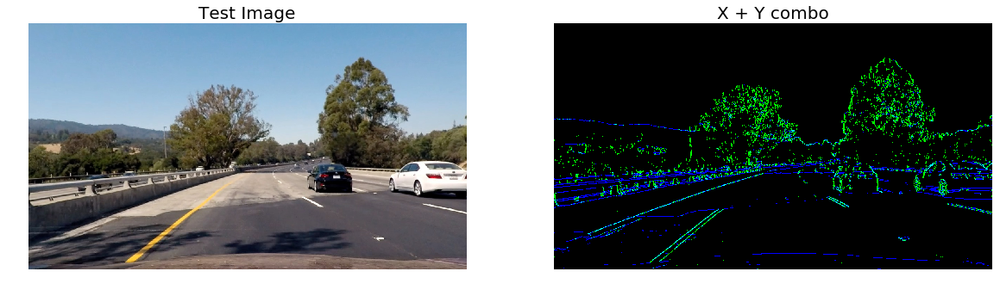

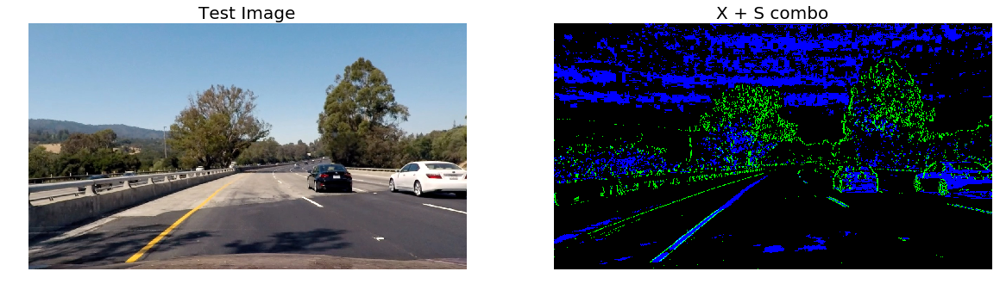

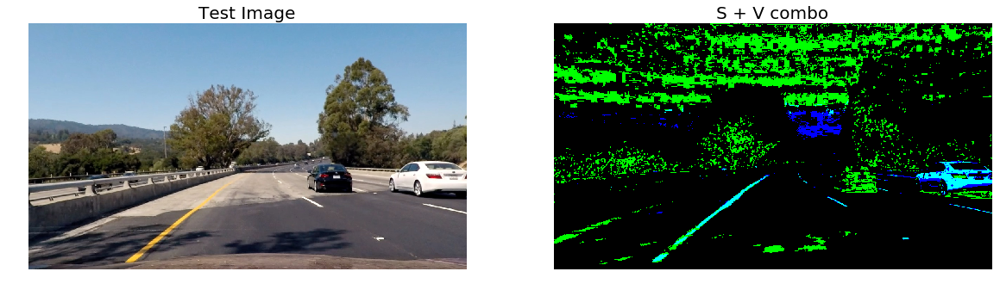

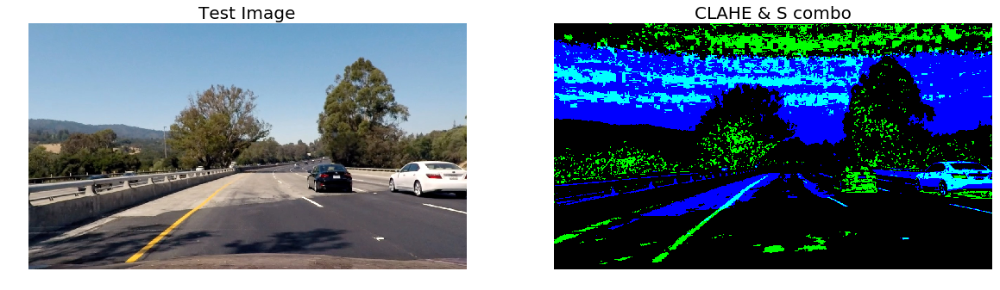

In [443]:
## Show thresholds stacked together in green and blue channels

img = test4

# Create binaries
sxy_stack, sxs_stack, sv_stack, cs_stack = stack_thresh(img)

# Visualize results
show_RGB(img, sxy_stack, chan1='BGR', chan2='gray', title1='Test Image', title2='X + Y combo')
show_RGB(img, sxs_stack, chan1='BGR', chan2='gray', title1='Test Image', title2='X + S combo')
show_RGB(img, sv_stack, chan1='BGR', chan2='gray', title1='Test Image', title2='S + V combo')
show_RGB(img, cs_stack, chan1='BGR', chan2='gray', title1='Test Image', title2='CLAHE & S combo')

#### CONCLUSION:
From the stack test above, it appears the best combonations involve the X gradient, saturation (S) channel, and value (V) channel. We'll explore these further in the next section when we combine them into a single binary. 

#### Thresholds Combination Test
This tests combines different thresholds into a method for identifying lane lines (represented by a single binary image). 

In [445]:
# Combined thresholding function

# def comb_thresh(img, channels, thresholds):
def comb_thresh(img):
        
    # Gradient thresholds
    sx_binary = abs_thresh(img, orient='x', sobel_kernel=3, thresh=(30,130))
    sy_binary = abs_thresh(img, orient='y', sobel_kernel=3, thresh=(50,140))
    mag_binary = mag_thresh(img, sobel_kernel=5, thresh=(50,150))
    
    # Color thresholds
    clahe_binary = clahe_thresh(img)  # contrast limited adaptive hist. equal.
    s_binary = hls_thresh(img, channel='S', thresh=(120,255))  # saturation channel
    v_binary = hsv_thresh(img, channel='V', thresh=(225,255))  # value channel

    ## Combinations of above thresholds:
    
    # Gradients
    grad = np.zeros_like(sx_binary)
    grad[((sx_binary == 1) | (sy_binary == 1)) | (mag_binary == 1)] = 1
    
    # S + V channels
    sv = ((s_binary == 1) | (v_binary == 1))
    
    # CLAHE + SV
    csv = ((clahe_binary == 1) | (s_binary == 1) | (v_binary == 1))
    
    # Gradient + SV
    gradsv = ((grad == 1) | (sv == 1))

    # Return various combinations to test
    return grad, clahe_binary, s_binary, v_binary, sv, csv, gradsv

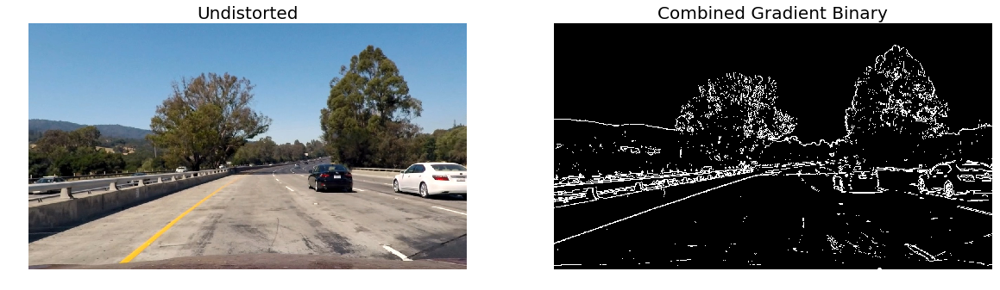

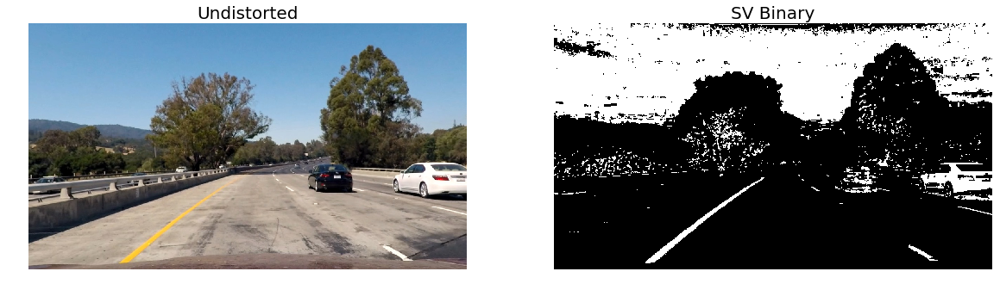

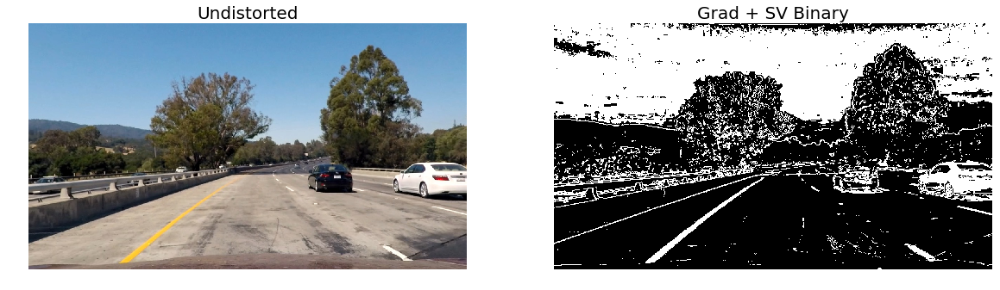

In [449]:
img = test1

grad, clahe_binary, s_binary, v_binary, sv, csv, gradsv = comb_thresh(img)

show_RGB(img, grad, title2='Combined Gradient Binary')
# show_RGB(img, clahe_binary, title2='CLAHE Binary')
# show_RGB(img, s_binary, title2='S Binary') 
# show_RGB(img, v_binary, title2='V Binary') 
show_RGB(img, sv, title2='SV Binary') 
# show_RGB(img, csv, title2='CSV Binary')
show_RGB(img, gradsv, title2='Grad + SV Binary') 

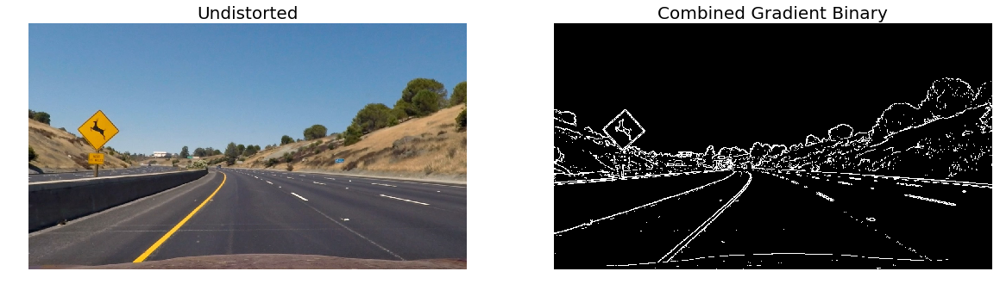

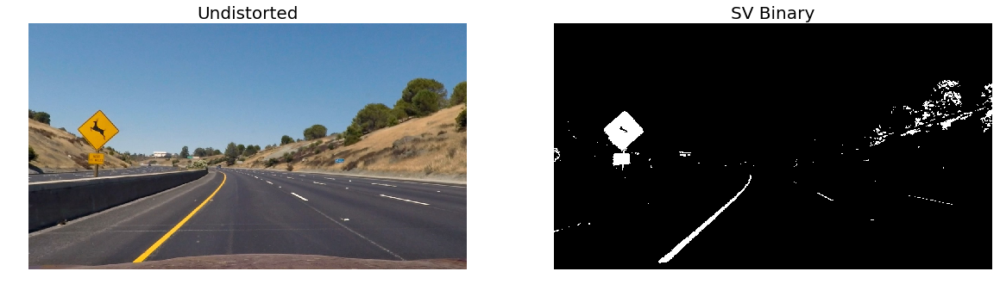

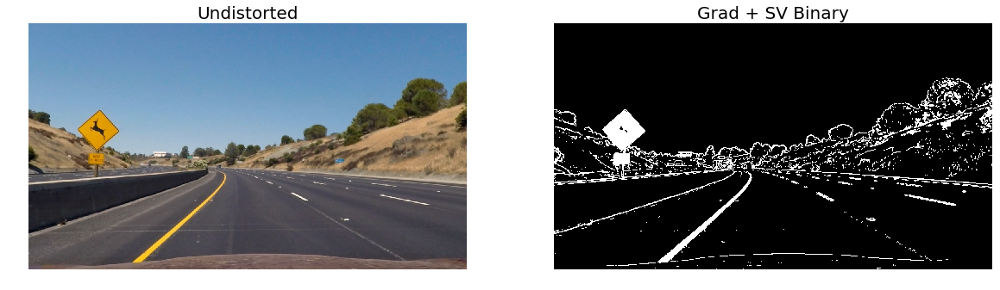

In [446]:
img = test2

grad, clahe_binary, s_binary, v_binary, sv, csv, gradsv = comb_thresh(img)

show_RGB(img, grad, title2='Combined Gradient Binary')
# show_RGB(img, clahe_binary, title2='CLAHE Binary')
# show_RGB(img, s_binary, title2='S Binary') 
# show_RGB(img, v_binary, title2='V Binary') 
show_RGB(img, sv, title2='SV Binary') 
# show_RGB(img, csv, title2='CSV Binary')
show_RGB(img, gradsv, title2='Grad + SV Binary') 

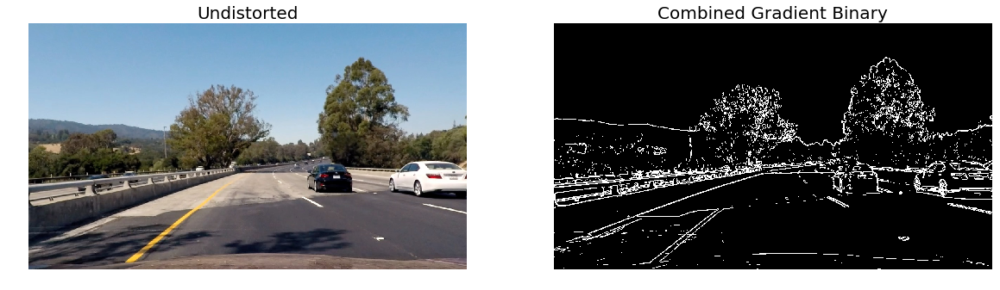

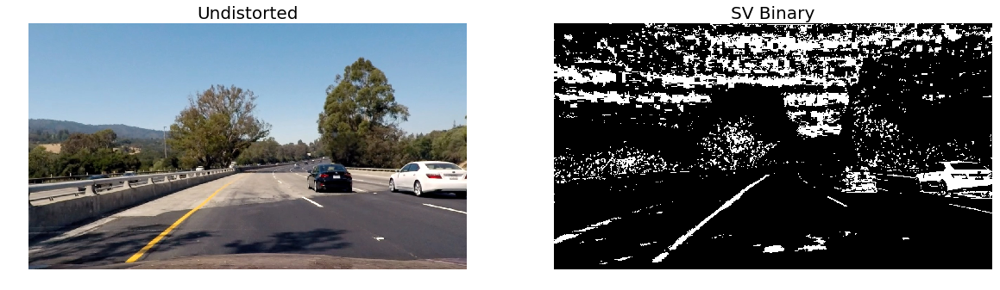

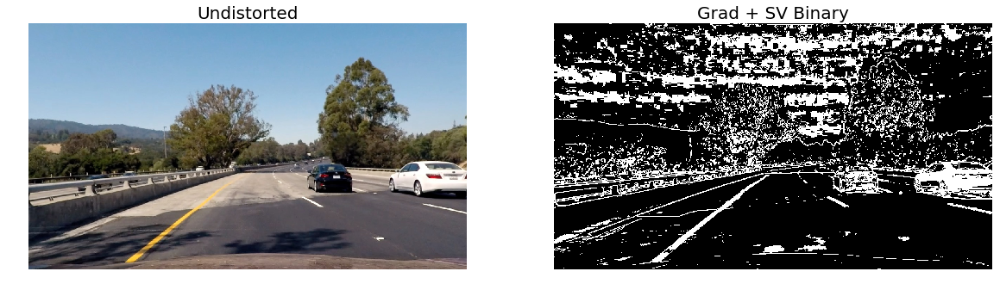

In [447]:
img = test4

grad, clahe_binary, s_binary, v_binary, sv, csv, gradsv = comb_thresh(img)

show_RGB(img, grad, title2='Combined Gradient Binary')
# show_RGB(img, clahe_binary, title2='CLAHE Binary')
# show_RGB(img, s_binary, title2='S Binary') 
# show_RGB(img, v_binary, title2='V Binary') 
show_RGB(img, sv, title2='SV Binary') 
# show_RGB(img, csv, title2='CSV Binary')
show_RGB(img, gradsv, title2='Grad + SV Binary') 

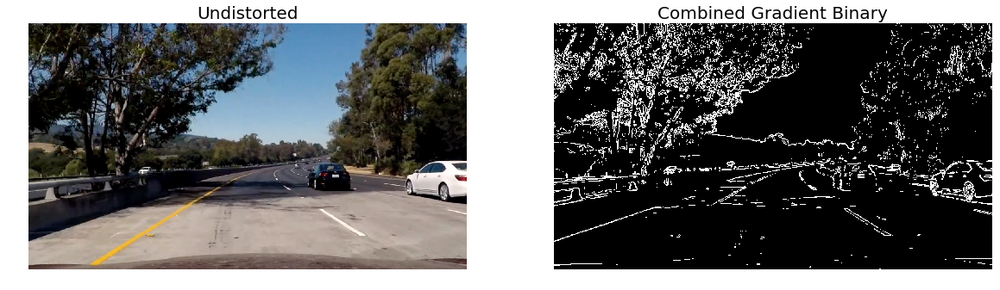

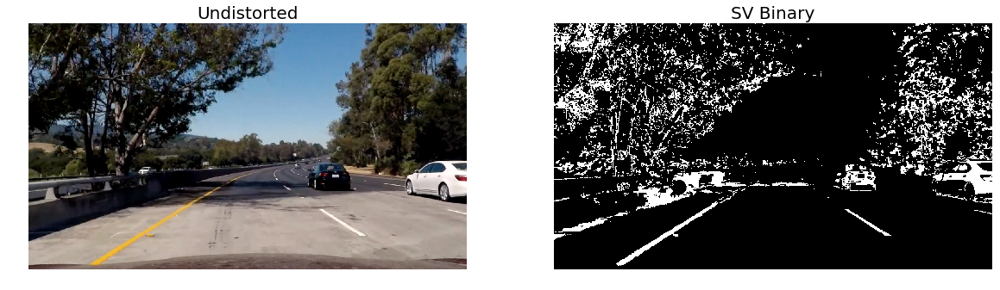

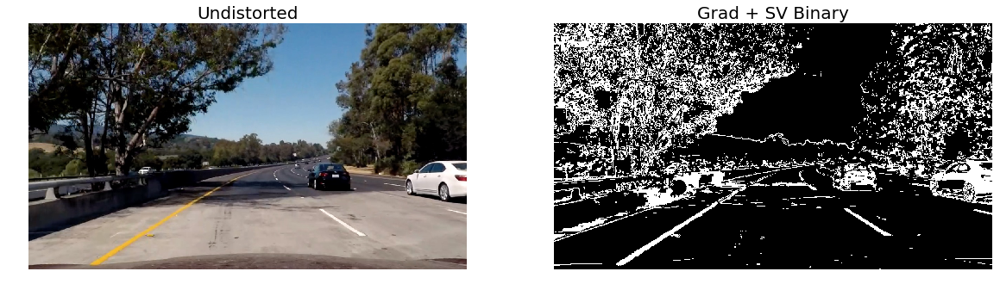

In [448]:
img = test5

grad, clahe_binary, s_binary, v_binary, sv, csv, gradsv = comb_thresh(img)

show_RGB(img, grad, title2='Combined Gradient Binary')
# show_RGB(img, clahe_binary, title2='CLAHE Binary')
# show_RGB(img, s_binary, title2='S Binary') 
# show_RGB(img, v_binary, title2='V Binary') 
show_RGB(img, sv, title2='SV Binary') 
# show_RGB(img, csv, title2='CSV Binary')
show_RGB(img, gradsv, title2='Grad + SV Binary') 

#### CONCLUSION:
It seems the the combination of the saturation (S) and value (V) channels does the cleanest job of identifying lane lines across different driving conditions. The gradient combo (X, Y, and magnitude) captures a lot of other noise in the image besides the lane lines, and doesn't perform well under bad lighting conditions. However, there are instances when the SV+Gradient combonation produces the best results. 

For example, in the two images immediately above, the addition of the Gradient combo picks up distant lane lines beyond the shadow that the SV combo misses. 

So, in the next section, we'll experiment with both the SV (saturation, value) and GSV (gradient, saturation, value) combinations to see which one performs best when we actually detect and draw the lane boundaries. 

---
## Step 4 | Perspective Transform

&nbsp;
### Create Mask for Region of Interest
Here we define the region of the image we want to focus on when trying to detect the lane lines.

In [460]:
def region(img, vert_map):
    '''Defines the region of interest within the image, i.e. the area where we expect the 
    lane lines to be located. The rest of the image is discarded (masked over).
    
    Arguments:
    img : the source image you want to modify
    vert_map : a dict of tuples with values >0 and <=1 that define where the vertices should 
                be placed relative to the image width and height
    '''
    # Define mask vertices
    vertices = np.array([[
        (vert_map['upper-right'][0]*img.shape[1], vert_map['upper-right'][1]*img.shape[0]), 
        (vert_map['lower-right'][0]*img.shape[1], vert_map['lower-right'][1]*img.shape[0]),
        (vert_map['lower-left'][0]*img.shape[1] , vert_map['lower-left'][1]*img.shape[0]),
        (vert_map['upper-left'][0]*img.shape[1], vert_map['upper-left'][1]*img.shape[0])
    ]], dtype=np.int32)
    
    # Create black mask
    mask = np.zeros_like(img, dtype=np.uint8)
    
    # Define mask fill color 
    if len(img.shape) == 3:
        n_channels = img.shape[2]
        ignore_mask_color = (255,) * n_channels
    else:
        ignore_mask_color = 255
        
    # Fill mask polygon   
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    # Apply mask to image
    masked_image = cv2.bitwise_and(img, mask)
    
    return masked_image

In [479]:
# Define the mask vertices as a percentage of the image width and height

mask_points = {
    'upper-left': (0.45, 0.6),
    'upper-right' : (0.55, 0.6),
    'lower-left' : (0.15, 0.95),
    'lower-right' : (0.95, 0.95)
}

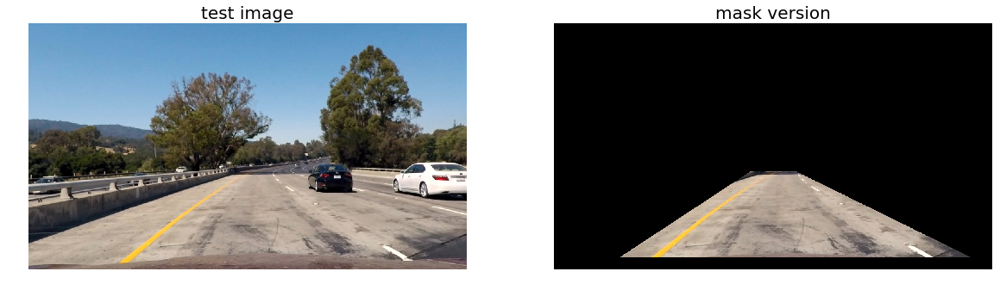

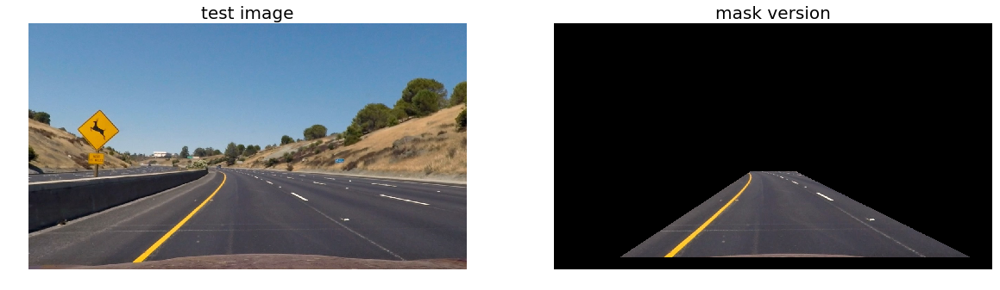

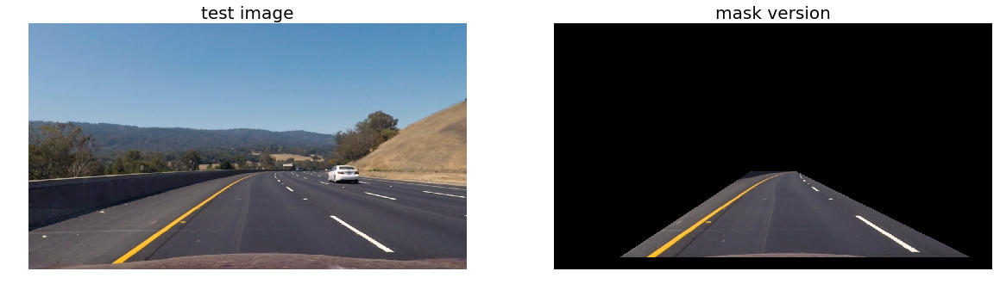

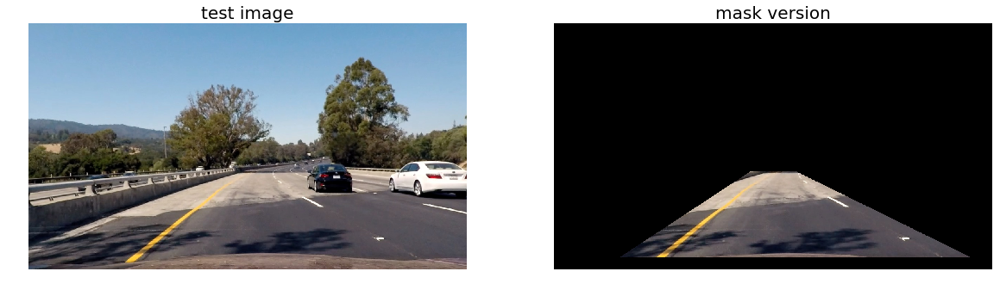

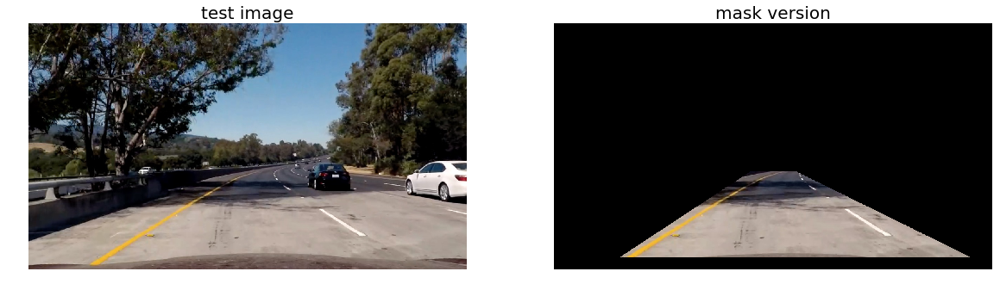

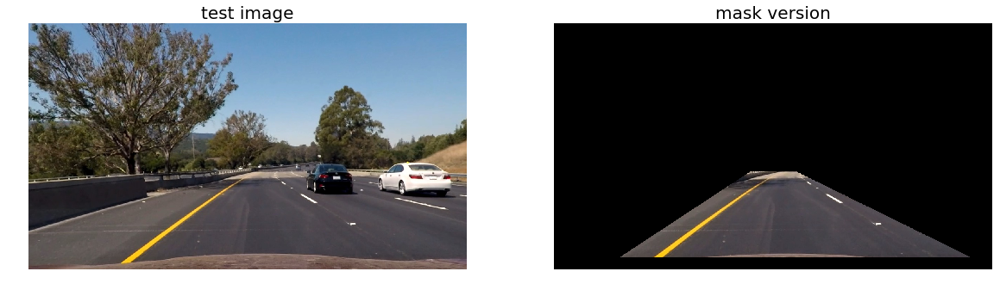

In [480]:
# Create masks for each test image
test1_mask = region(test1, mask_points)
test2_mask = region(test2, mask_points)
test3_mask = region(test3, mask_points)
test4_mask = region(test4, mask_points)
test5_mask = region(test5, mask_points)
test6_mask = region(test6, mask_points)

# Visualize the test images and masks side-by-side
show_RGB(test1, test1_mask, chan2='BGR', title1='test image', title2='mask version') 
show_RGB(test2, test2_mask, chan2='BGR', title1='test image', title2='mask version') 
show_RGB(test3, test3_mask, chan2='BGR', title1='test image', title2='mask version') 
show_RGB(test4, test4_mask, chan2='BGR', title1='test image', title2='mask version') 
show_RGB(test5, test5_mask, chan2='BGR', title1='test image', title2='mask version')
show_RGB(test6, test6_mask, chan2='BGR', title1='test image', title2='mask version') 

---
## Step 5 | Detect Lane Pixels and Fit to the Lane Boundary

---
## Step 6 | Determine Lane Curvature and Vehicle Position

---
## Step 7 | Overlay the Lane Boundaries onto the Original Image

---
## Step 8 | Output Video
Here we need create a visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position with respect to center.